In [91]:
import numpy as np
import pickle
import matplotlib.pyplot as plt
import seaborn as sns
import sys
sys.path.append("/home/ines/Documents/sigdigs/lib/python3.10/site-packages")
import significantdigits as sig
from sklearn.metrics import mean_absolute_error as mae

## Model Weight Analysis

Conv layer 0	 Frobenius norm:  7.9454026&emsp;Conv bias layer 0	 Frobenius norm:  1.0464903
<br>
Conv layer 1	 Frobenius norm:  11.594568&emsp;Conv bias layer 1	 Frobenius norm:  0.949895
<br>
Conv layer 2	 Frobenius norm:  14.445502&emsp;Conv bias layer 2	 Frobenius norm:  0.90034986
<br>
Conv layer 3	 Frobenius norm:  16.85015&emsp;Conv bias layer 3	 Frobenius norm:  0.86896753
<br>
Conv layer 4	 Frobenius norm:  19.010769&emsp;Conv bias layer 4	 Frobenius norm:  0.8412659
<br>
Conv layer 5	 Frobenius norm:  21.236866&emsp;Conv bias layer 5	 Frobenius norm:  0.8256418
<br>
Conv layer 6	 Frobenius norm:  23.252726&emsp;Conv bias layer 6	 Frobenius norm:  0.8017132
<br>
Conv layer 7	 Frobenius norm:  25.174028&emsp;Conv bias layer 7	 Frobenius norm:  0.78111017
<br>
Conv layer 8	 Frobenius norm:  27.205687&emsp;Conv bias layer 8	 Frobenius norm:  0.75759435
<br>
Conv layer 9	 Frobenius norm:  29.336905&emsp;Conv bias layer 9	 Frobenius norm:  0.74173677
<br>
Conv layer 10	 Frobenius norm:  30.973385&emsp;Conv bias layer 10	 Frobenius norm:  0.7271561
<br>
Conv layer 11	 Frobenius norm:  33.0154&emsp;Conv bias layer 11	 Frobenius norm:  0.70450115
<br>
Conv layer 12	 Frobenius norm:  34.638306&emsp;Conv bias layer 12	 Frobenius norm:  0.69196945
<br>
Conv layer 13	 Frobenius norm:  36.104176&emsp;Conv bias layer 13	 Frobenius norm:  0.6758336
<br>
Conv layer 14	 Frobenius norm:  38.315197&emsp;Conv bias layer 14	 Frobenius norm:  0.67392147
<br>
Conv layer 15	 Frobenius norm:  40.361156&emsp;Conv bias layer 15	 Frobenius norm:  0.6726576
<br>

## Mean Absolute Error

## Specific

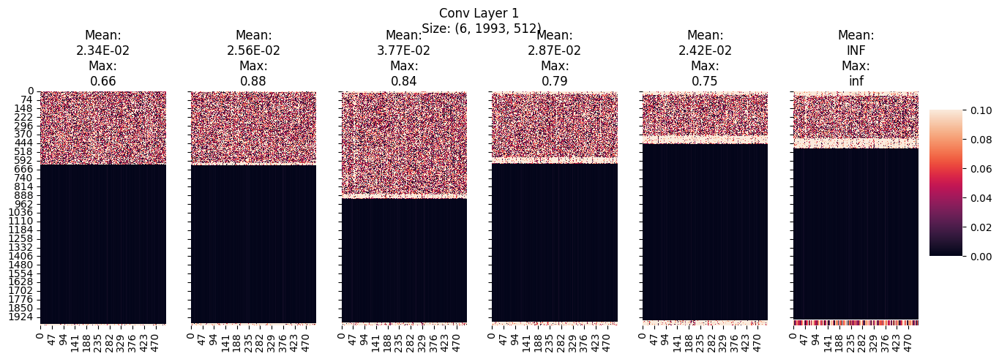

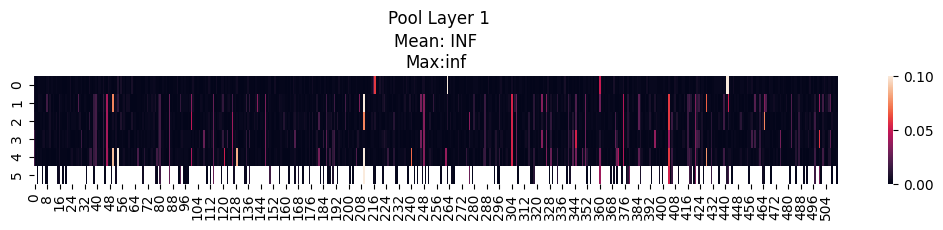

(6, 512)


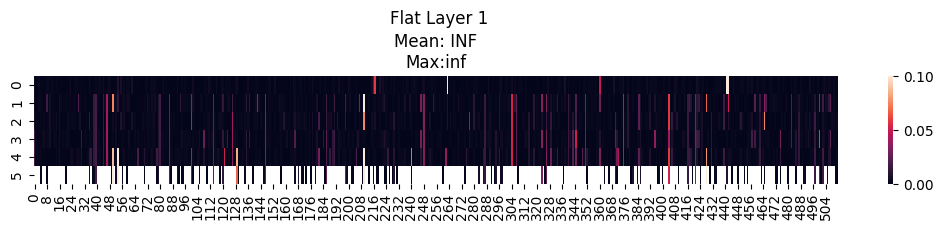

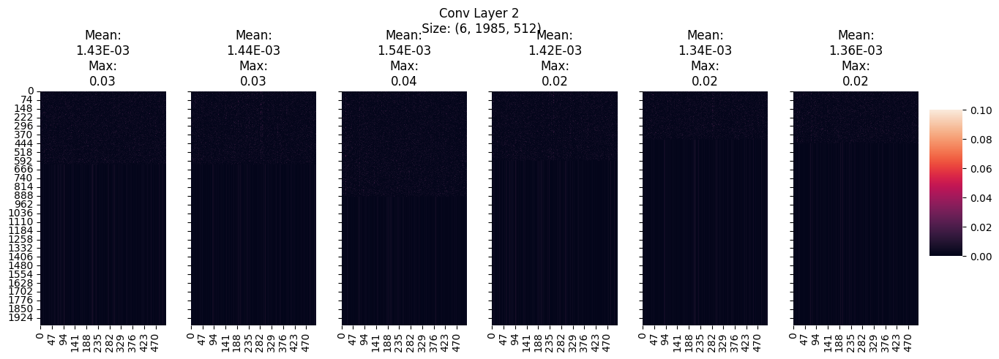

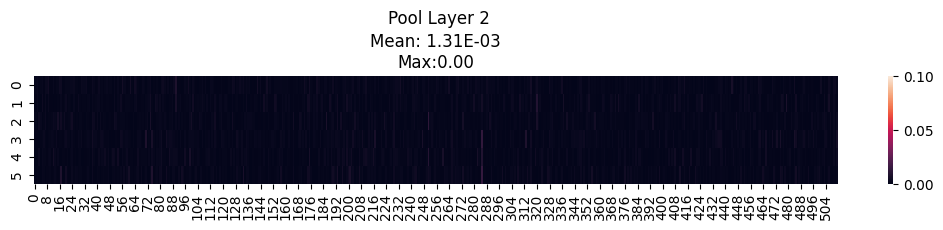

(6, 512)


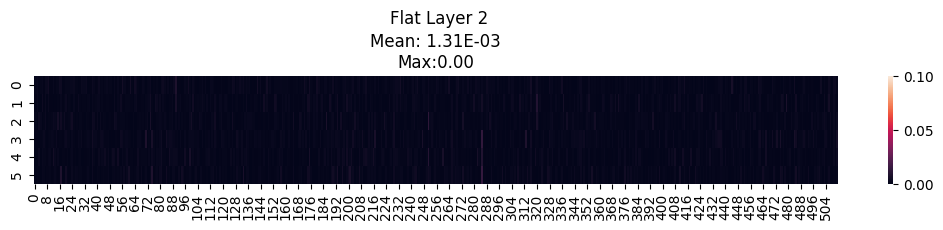

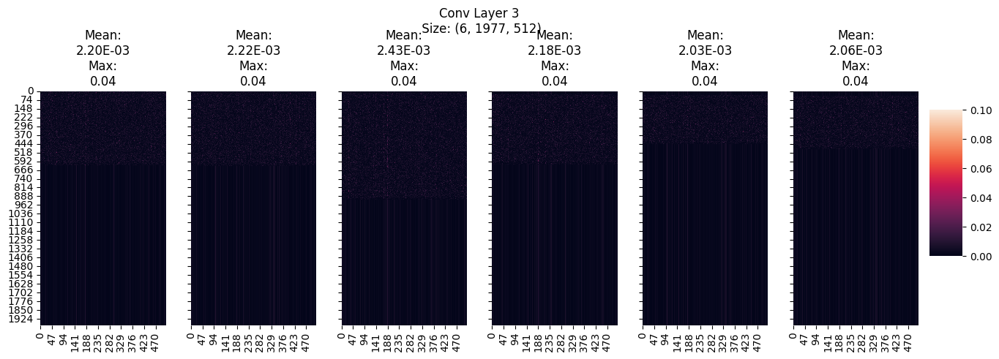

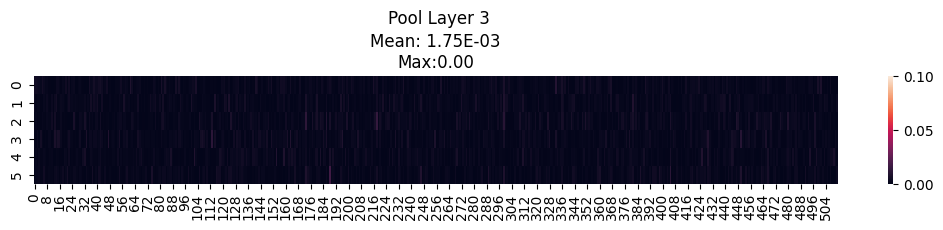

(6, 512)


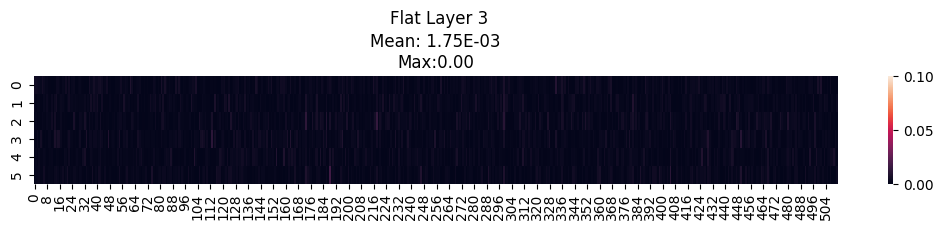

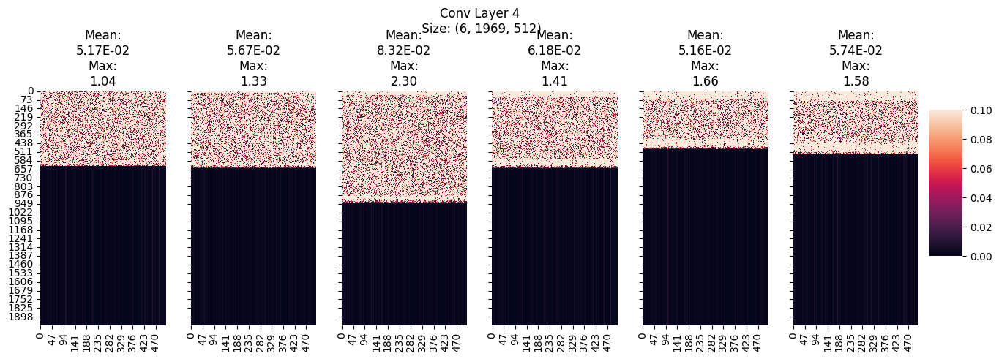

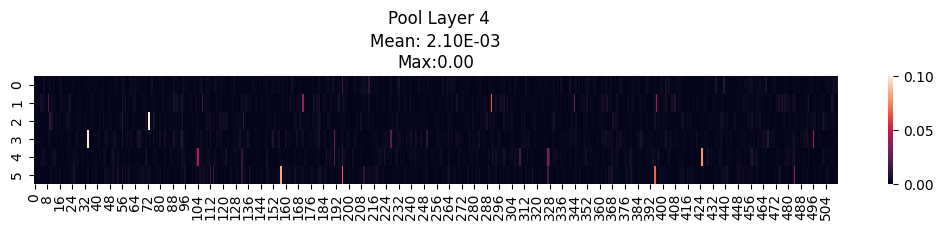

(6, 512)


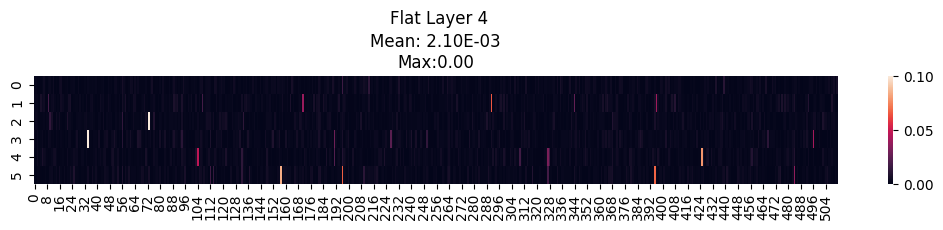

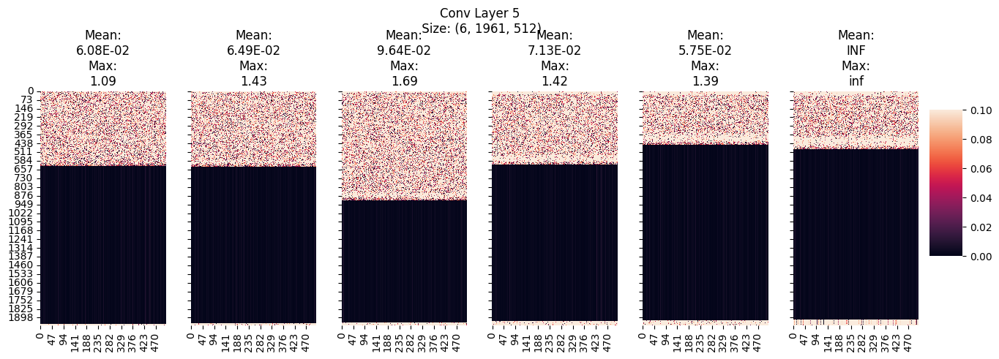

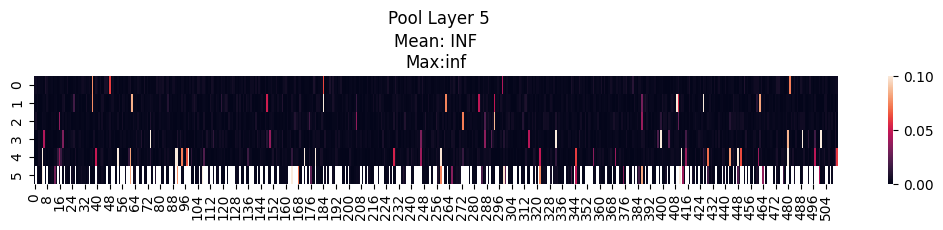

(6, 512)


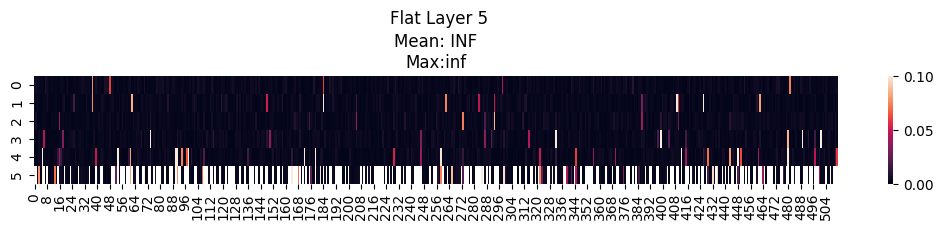

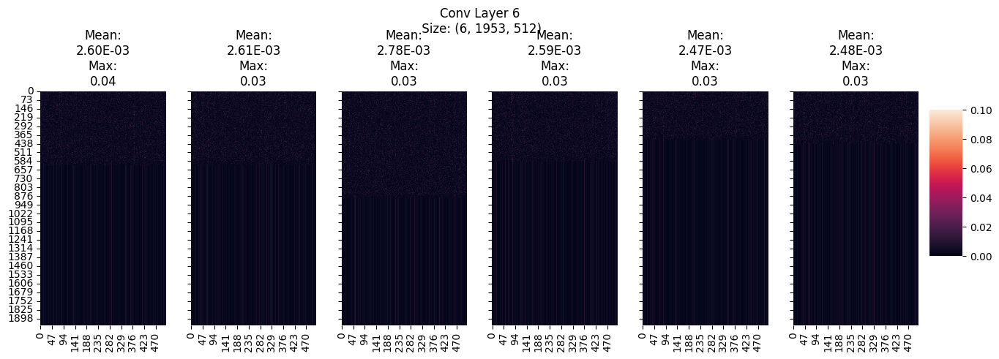

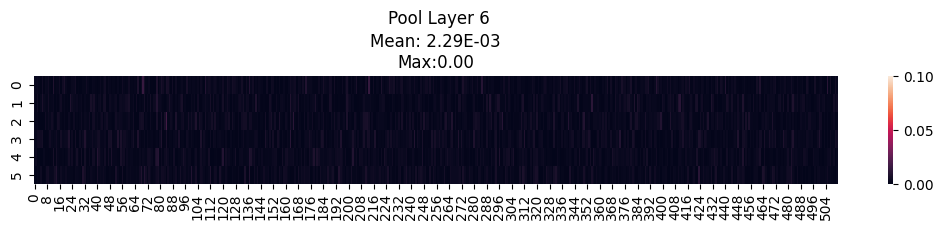

(6, 512)


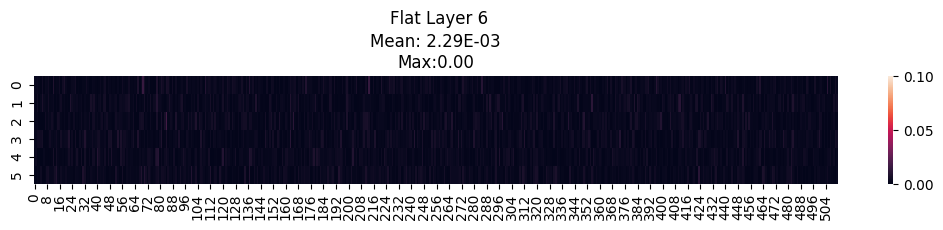

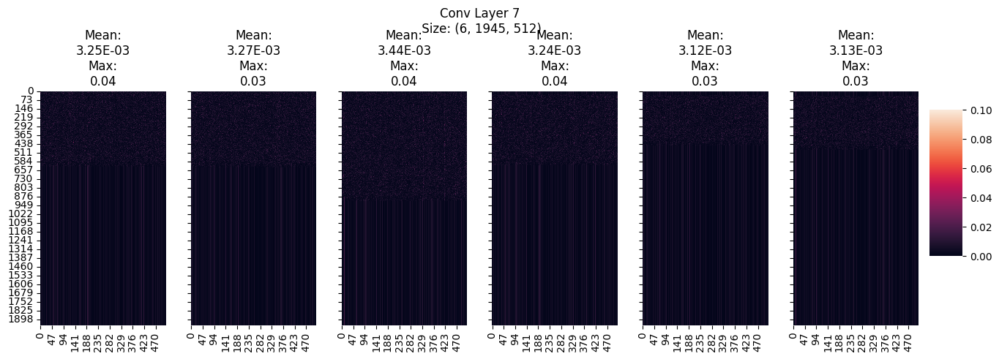

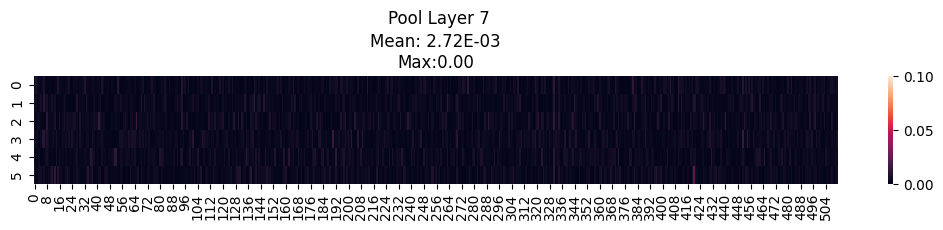

(6, 512)


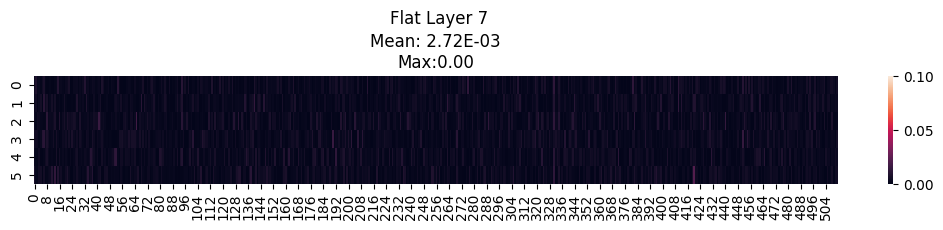

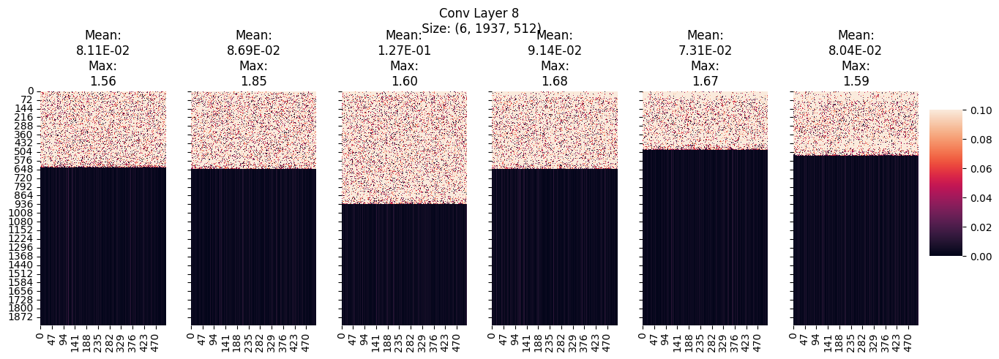

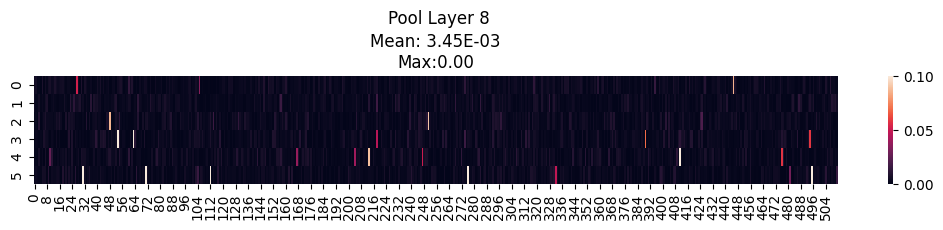

(6, 512)


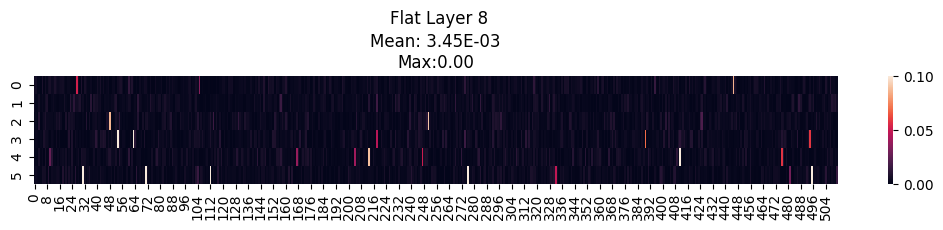

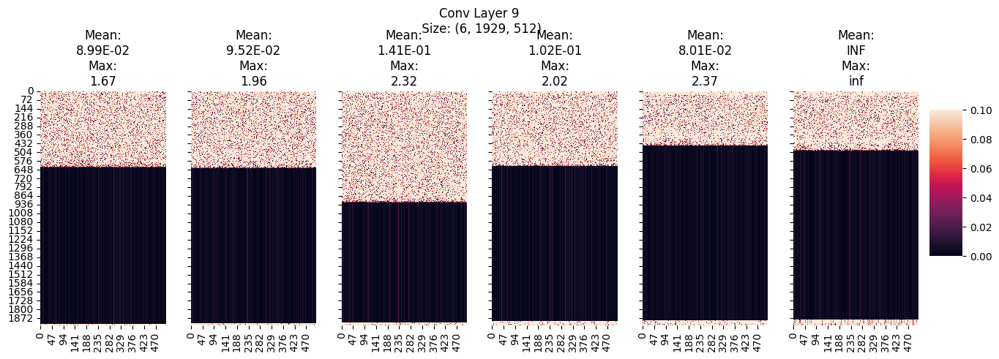

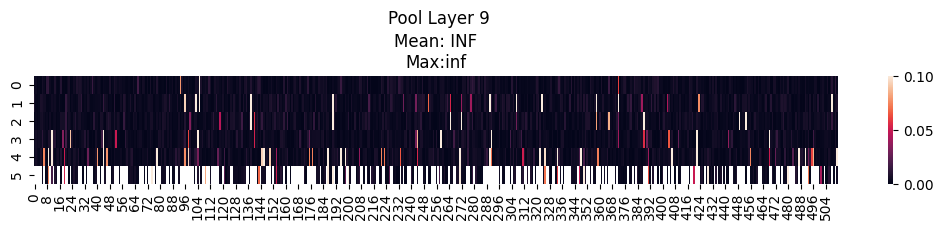

(6, 512)


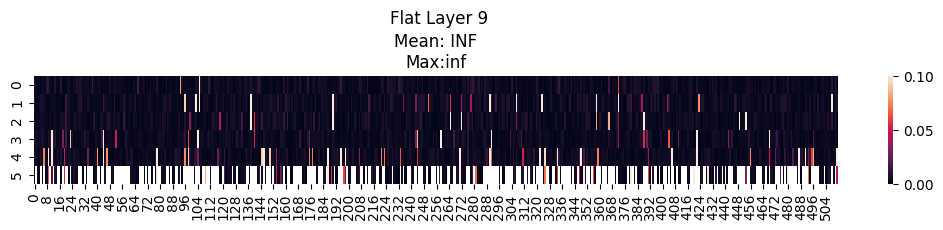

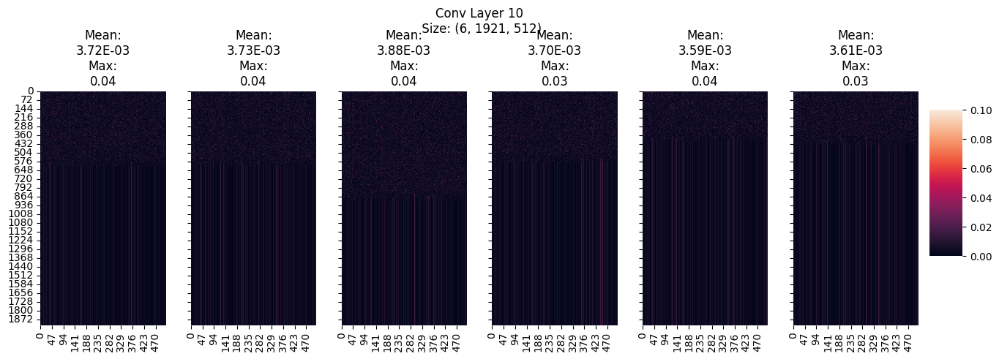

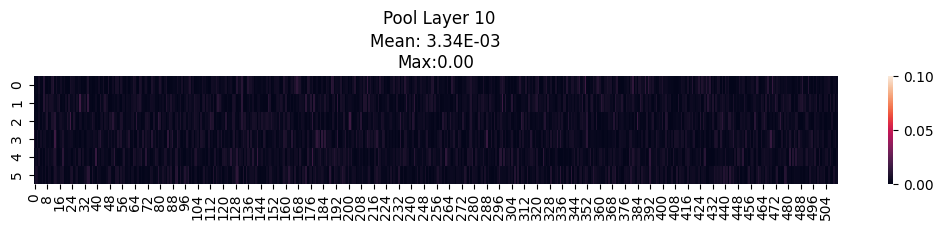

(6, 512)


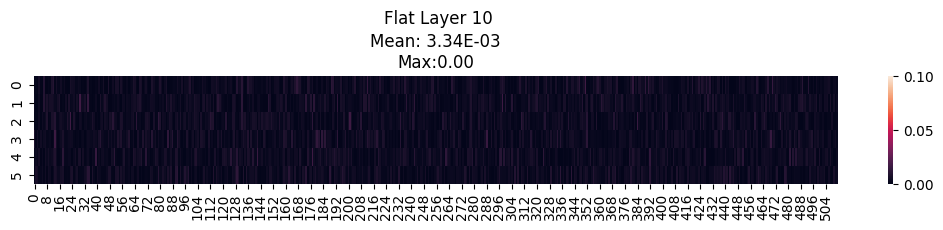

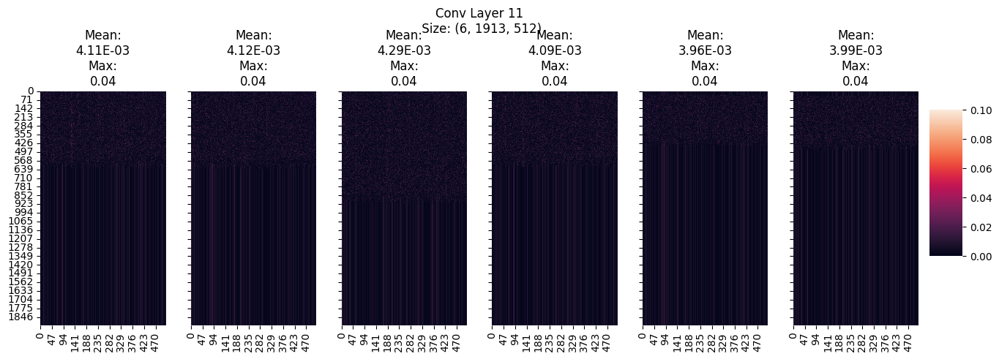

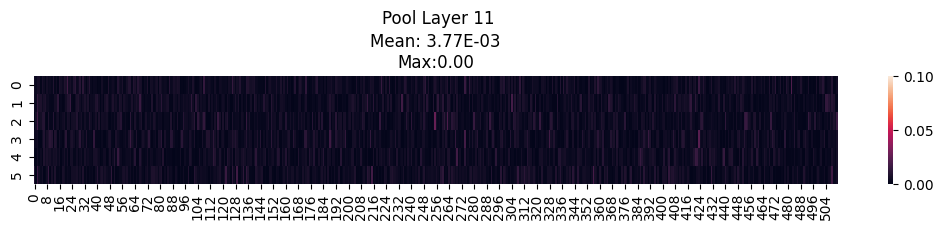

(6, 512)


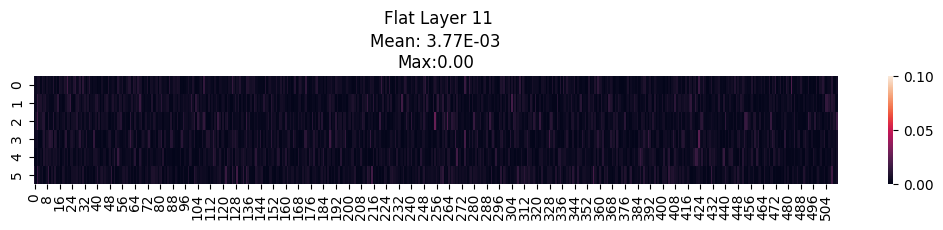

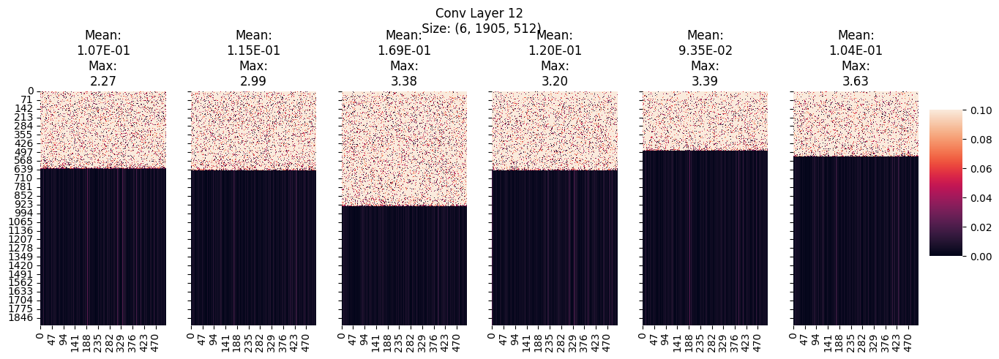

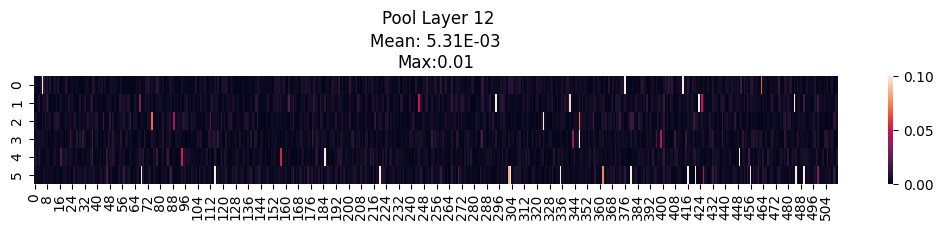

(6, 512)


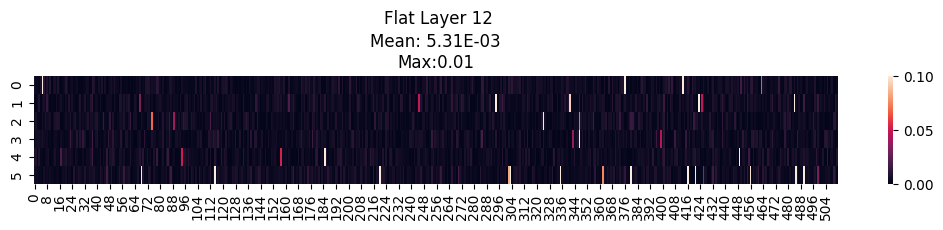

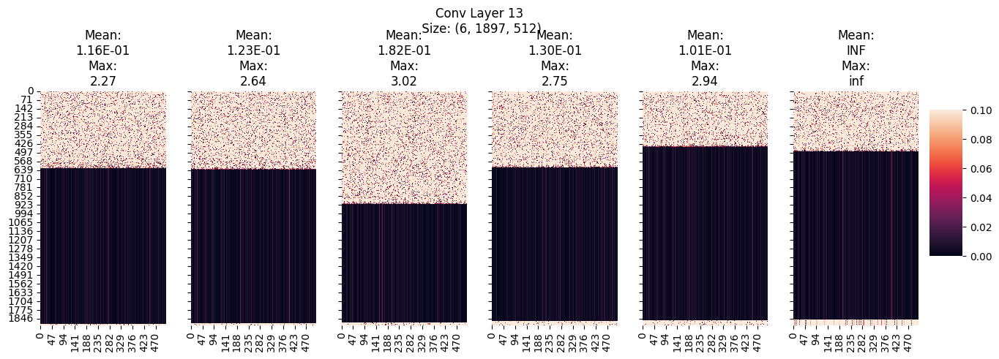

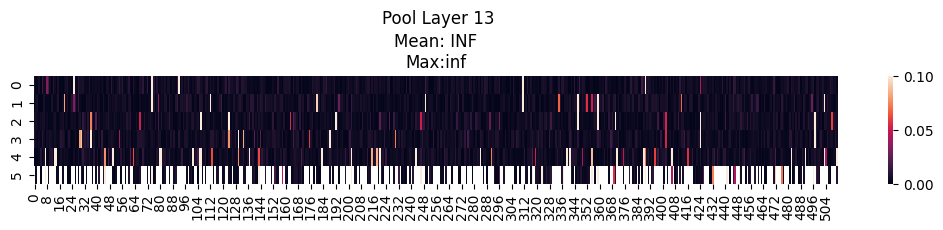

(6, 512)


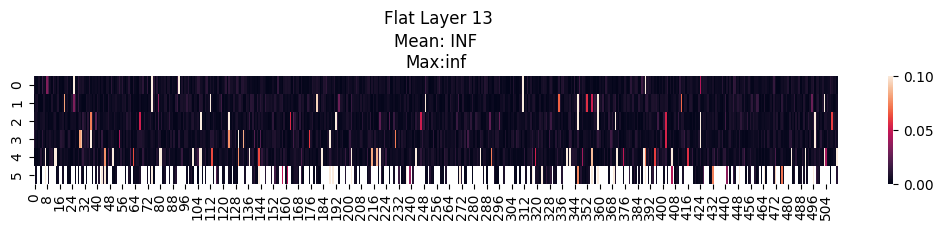

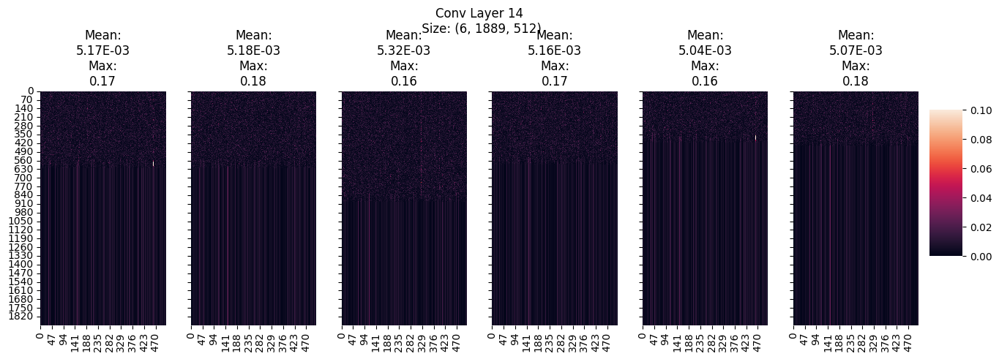

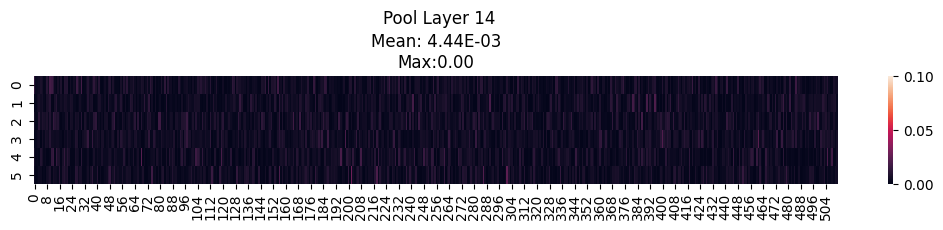

(6, 512)


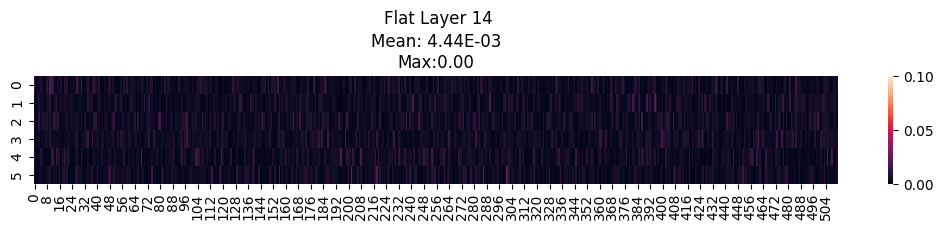

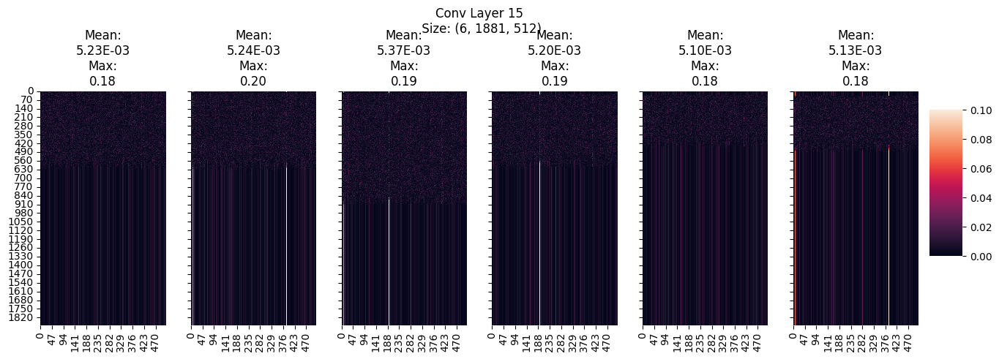

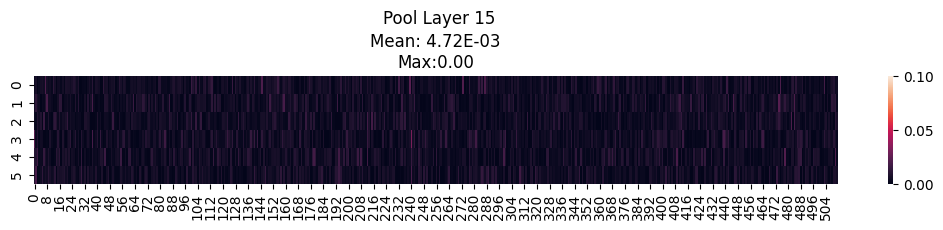

(6, 512)


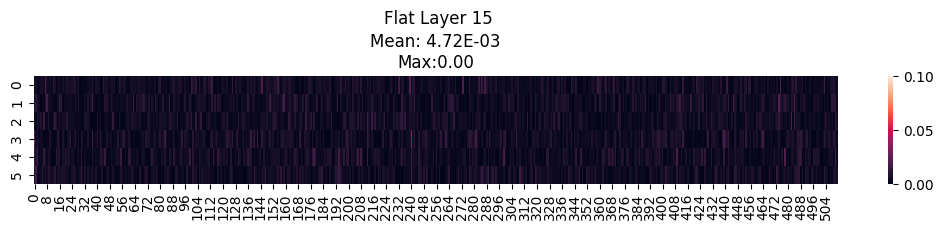

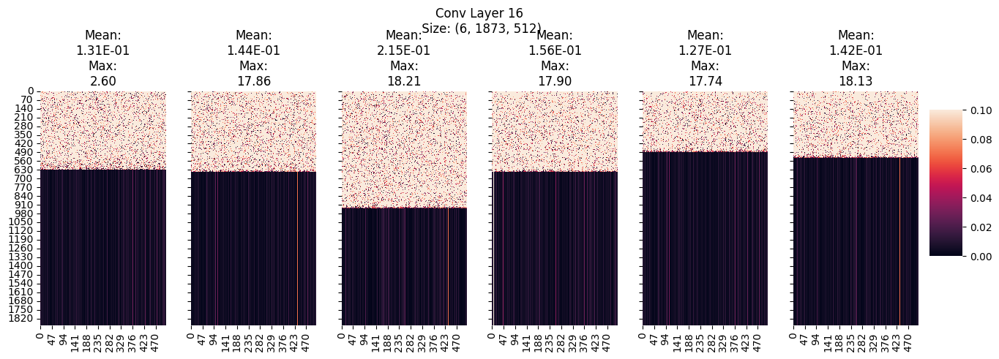

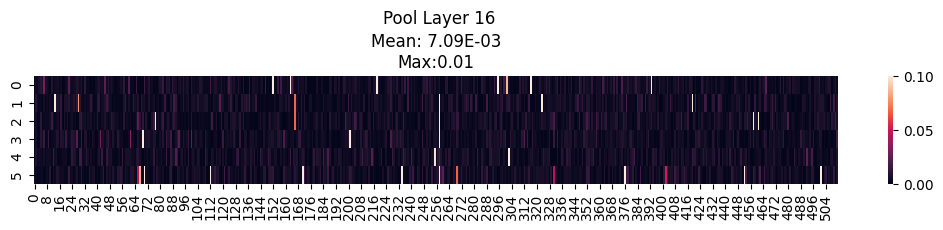

(6, 512)


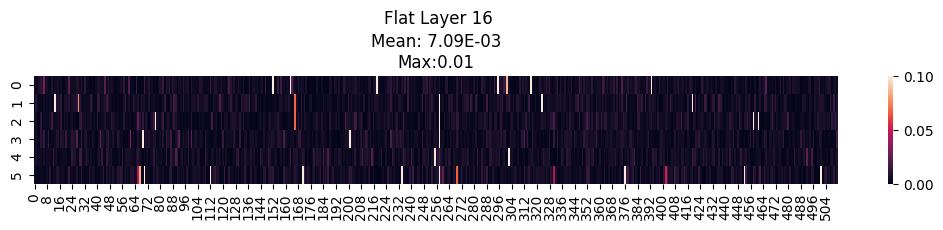

In [82]:
def mean_absolute_error(actual, predicted):
    return np.mean(np.abs(np.array(actual) - np.array(predicted)),axis=0)


for layer in range(1,17):
    conv = pickle.load(open(f'embeddings/1_double_p23_r6_conv_{layer}_embeddings.pkl', 'rb'))[0]
    pool = pickle.load(open(f'embeddings/1_double_p23_r6_pool_{layer}_embeddings.pkl', 'rb'))[0]
    flat = pickle.load(open(f'embeddings/1_double_p23_r6flat_{layer}_embeddings.pkl', 'rb'))[0]
       
    # conv = np.array(conv)
#     pool = np.array(pool)
#     flat = np.array(flat)
    
#     conv_mean = np.mean(conv, axis=0)
#     pool_mean = np.mean(pool, axis=0)
#     flat_mean = np.mean(flat, axis=0)

    reduced_conv = pickle.load(open(f'embeddings/1_double_p23_r5_conv_{layer}_embeddings.pkl', 'rb'))[0]
    reduced_pool = pickle.load(open(f'embeddings/1_double_p23_r5_pool_{layer}_embeddings.pkl', 'rb'))[0]
    reduced_flat = pickle.load(open(f'embeddings/1_double_p23_r5flat_{layer}_embeddings.pkl', 'rb'))[0]
#     print(reduced_flat.shape, flat_mean.shape, flat.shape)
#     print(reduced_pool.shape, pool_mean.shape, pool.shape)
    
    # print(reduced_conv.shape, conv.shape)
    
    mae_conv = mean_absolute_error(conv.reshape(1, conv.shape[0], conv.shape[1], conv.shape[2]), 
                              reduced_conv.reshape(1, reduced_conv.shape[0], reduced_conv.shape[1], reduced_conv.shape[2]))

    mae_pool = mean_absolute_error(pool.reshape(1, pool.shape[0], pool.shape[1], pool.shape[2]), 
                              reduced_pool.reshape(1, reduced_pool.shape[0], reduced_pool.shape[1], reduced_pool.shape[2]))

    mae_flat = mean_absolute_error(flat.reshape(1, flat.shape[0], flat.shape[1]), #flat_mean.shape[2]), 
                              reduced_flat.reshape(1, reduced_flat.shape[0], reduced_flat.shape[1])) #reduced_flat.shape[2]))

    fig, axn = plt.subplots(1, 6, figsize=(15,5), sharex=True, sharey=True)
    cbar_ax = fig.add_axes([.91, .3, .03, .4])

    for i, ax in enumerate(axn.flat):
        sns.heatmap(data=mae_conv[i,:,:], ax=ax,
                    # cbar=True,
                    cbar=i == 0,
                    vmin=0., vmax=0.1,
                    cbar_ax=None if i else cbar_ax
                   )
        ax.set_title(f'Mean:\n{np.mean(mae_conv[i,:,:]):.2E}\nMax:\n{np.max(mae_conv[i,:,:]):.2f}')

    fig.suptitle(f"Conv Layer {layer}\n Size: {conv.shape}")
    plt.subplots_adjust(top=0.75, left=.1)
    plt.show()
    # break
    
    # print(mae_pool.shape)
    fig, ax = plt.subplots(1, 1, figsize=(15,2), sharex=True, sharey=True)
#     cbar_ax = fig.add_axes([.91, .3, .03, .4])

#     for i, ax in enumerate(axn.flat):
    sns.heatmap(data=mae_pool.squeeze(), ax=ax, 
                cbar=True,
#                 cbar=i == 0,
                vmin=0., vmax=0.1,
#                 cbar_ax=None if i else cbar_ax
               )
    ax.set_title(f'Mean: {np.mean(mae_pool):.2E}\nMax:{np.mean(mae_pool):.2f}')

    fig.suptitle(f"Pool Layer {layer}")
    plt.subplots_adjust(top=0.65, left=.23)

    plt.show()
    
    
    
    fig, ax = plt.subplots(1, 1, figsize=(15,2), sharex=True, sharey=True)
#     cbar_ax = fig.add_axes([.91, .3, .03, .4])
    print(mae_flat.shape)

#     for i, ax in enumerate(axn.flat):
    sns.heatmap(data=mae_flat, ax=ax, 
                cbar=True,
#                 cbar=i == 0,
                vmin=0., vmax=0.1,
#                 cbar_ax=None if i else cbar_ax
               )
    ax.set_title(f'Mean: {np.mean(mae_flat):.2E}\nMax:{np.mean(mae_flat):.2f}')

    fig.suptitle(f"Flat Layer {layer}")
    plt.subplots_adjust(top=0.65, left=.23)

    plt.show()

    # break
    


## General

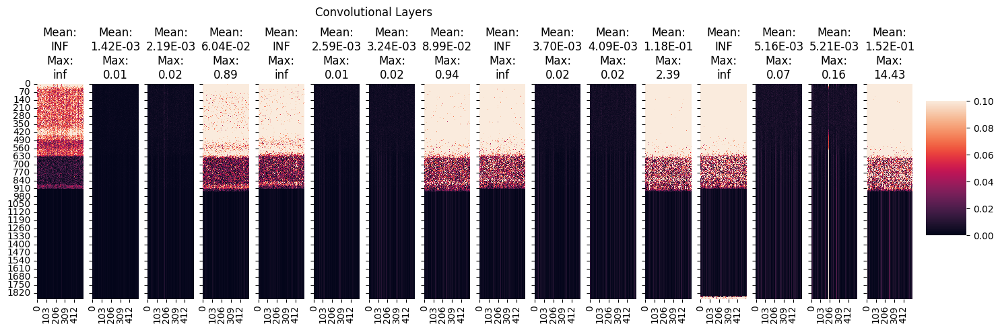

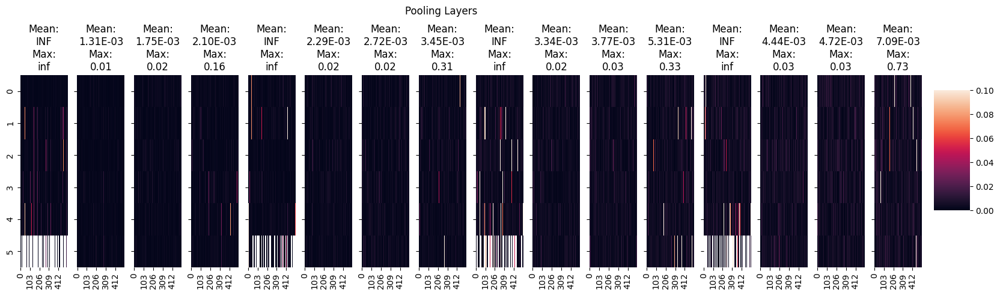

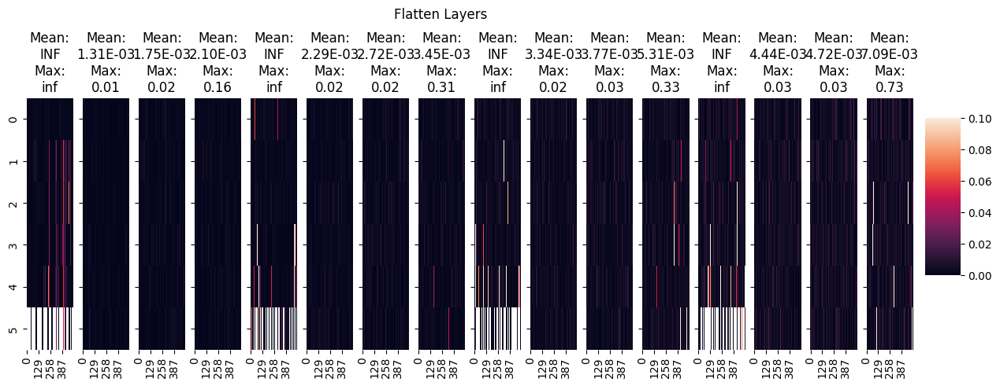

In [106]:
def mean_absolute_error(actual, predicted):
    return np.mean(np.abs(np.array(actual) - np.array(predicted)),axis=0)

fig, axn = plt.subplots(1, 16, figsize=(20,5), sharex=True, sharey=True)
cbar_ax = fig.add_axes([.91, .3, .03, .4])
    
for layer, ax in enumerate(axn.flat):

    conv = pickle.load(open(f'embeddings/1_double_p23_r6_conv_{layer+1}_embeddings.pkl', 'rb'))[0]
    
    
#     conv_mean = np.mean(conv, axis=0)


    reduced_conv = pickle.load(open(f'embeddings/1_double_p23_r5_conv_{layer+1}_embeddings.pkl', 'rb'))[0]
    
    mae_conv = mean_absolute_error(conv.reshape(1, conv.shape[0], conv.shape[1], conv.shape[2]), 
                              reduced_conv.reshape(1, reduced_conv.shape[0], reduced_conv.shape[1], reduced_conv.shape[2]))
    
    mae_conv = np.mean(mae_conv, axis=0)
                
    
    sns.heatmap(data=mae_conv, ax=ax,
#                 cbar=True,
                cbar=layer == 0,
                vmin=0, vmax=0.1,
                cbar_ax=None if layer else cbar_ax
               )
    ax.set_title(f'Mean:\n{np.mean(mae_conv):.2E}\nMax:\n{np.amax(mae_conv):.2f}')
    

fig.suptitle(f"Convolutional Layers")
plt.subplots_adjust(top=0.75, left=.25)
plt.show()


    
fig, axn = plt.subplots(1, 16, figsize=(20,5), sharex=True, sharey=True)
cbar_ax = fig.add_axes([.91, .3, .03, .4])
    
for layer, ax in enumerate(axn.flat):
    
    pool = pickle.load(open(f'embeddings/1_double_p23_r6_pool_{layer+1}_embeddings.pkl', 'rb'))[0]
        
    # pool = np.array(pool)    
    # pool_mean = np.mean(pool, axis=0)

    reduced_pool = pickle.load(open(f'embeddings/1_double_p23_r5_pool_{layer+1}_embeddings.pkl', 'rb'))[0]
    
#     print(reduced_pool.shape, pool_mean.shape)
    mae_pool = mean_absolute_error(pool.squeeze(), 
                              reduced_pool.squeeze())
    
#     mae_pool = np.mean(mae_pool, axis=0)

    
    sns.heatmap(data=mae_pool.squeeze(), ax=ax,
#                 cbar=False,
                cbar=layer == 0,
                vmin=0, vmax=0.1,
                cbar_ax=None if layer else cbar_ax
               )
    ax.set_title(f'Mean:\n{np.mean(mae_pool):.2E}\nMax:\n{np.amax(mae_pool):.2f}')
fig.suptitle(f"Pooling Layers")
plt.subplots_adjust(top=0.75, left=.15)
plt.show()


fig, axn = plt.subplots(1, 16, figsize=(15,5), sharex=True, sharey=True)
cbar_ax = fig.add_axes([.91, .3, .03, .4])  
for layer, ax in enumerate(axn.flat):
    
    # flat = []
    # for iteration in range(1,11):
    flat = pickle.load(open(f'embeddings/1_double_p23_r6flat_{layer+1}_embeddings.pkl', 'rb'))[0]
        
    # flat = np.array(flat)
    # flat_mean = np.mean(flat, axis=0)

    reduced_flat = pickle.load(open(f'embeddings/1_double_p23_r5flat_{layer+1}_embeddings.pkl', 'rb'))[0]
#     print(reduced_flat.shape, flat_mean.shape)
    
    mae_flat = mean_absolute_error(flat.reshape(1, flat.shape[0], flat.shape[1]), 
                              reduced_flat.reshape(1, reduced_flat.shape[0], reduced_flat.shape[1]))
    
#     mae_flat = np.mean(mae_flat, axis=0)

    sns.heatmap(data=mae_flat, ax=ax,
#                 cbar=True,
                cbar=layer == 0,
                vmin=0, vmax=0.1,
                cbar_ax=None if layer else cbar_ax
               )
    ax.set_title(f'Mean:\n{np.mean(mae_flat):.2E}\nMax:\n{np.amax(mae_flat):.2f}')
fig.suptitle(f"Flatten Layers")
plt.subplots_adjust(top=0.75, left=.15)
plt.show()

In [108]:
reduced_pool.shape, pool.shape

((6, 1, 512), (6, 1, 512))

## Significant Bits
* Is one sample enough for accurate results? Not really ignore this metric for now

## Specific

/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


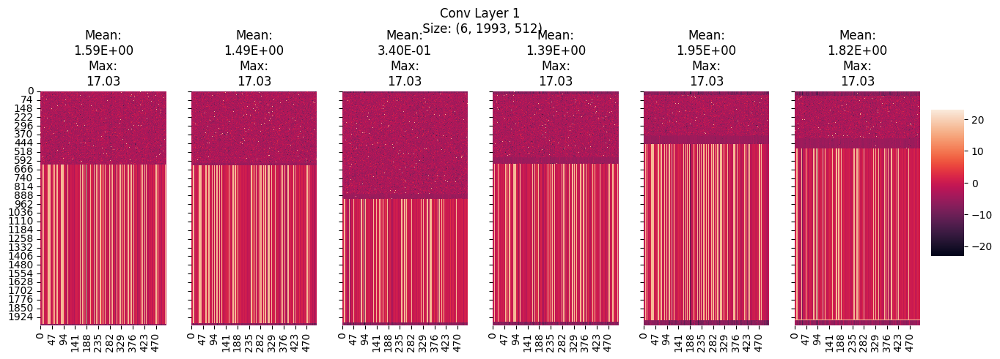

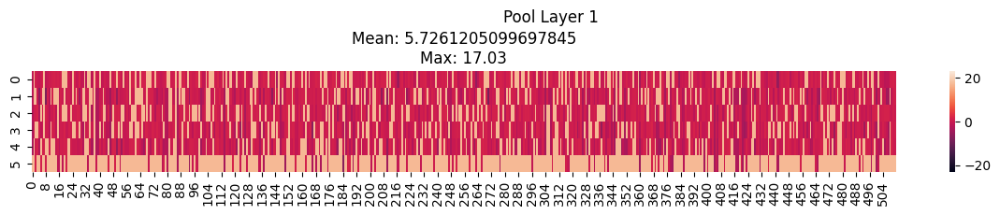

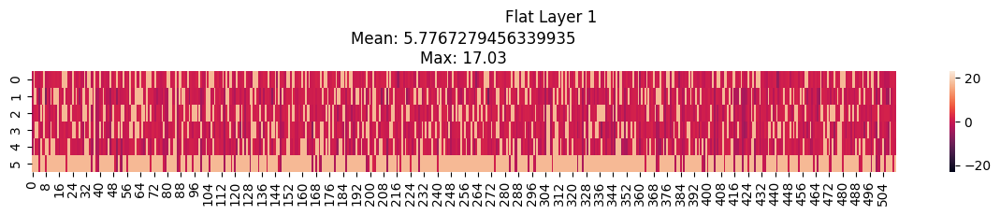

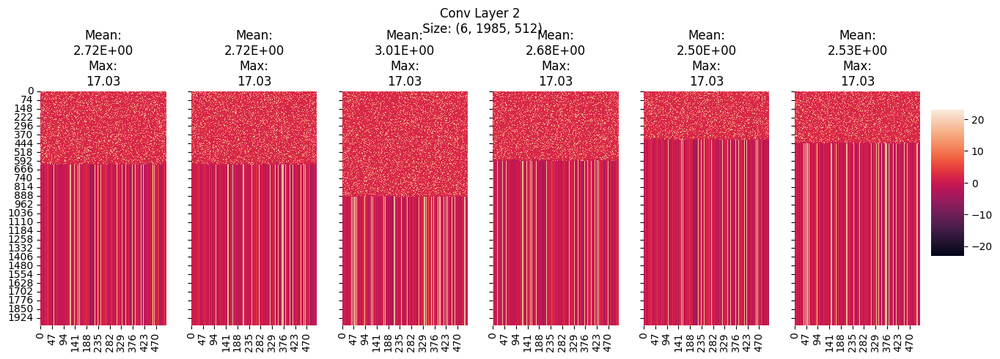

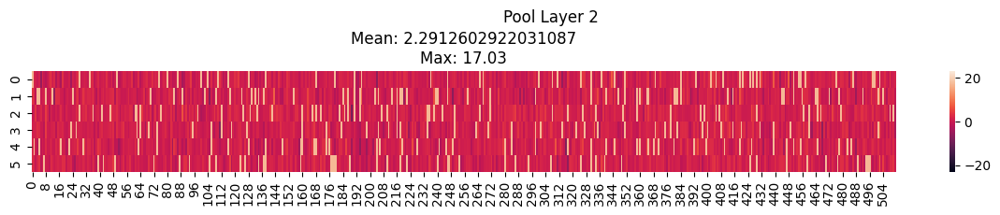

...

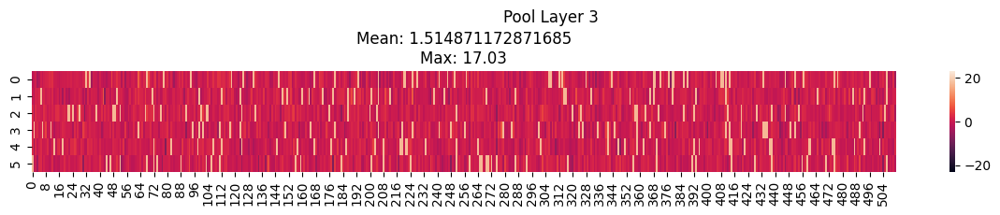

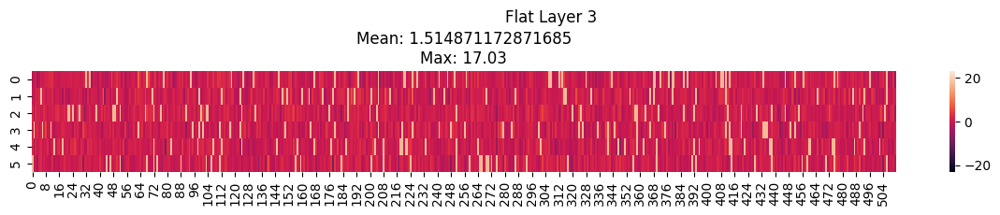

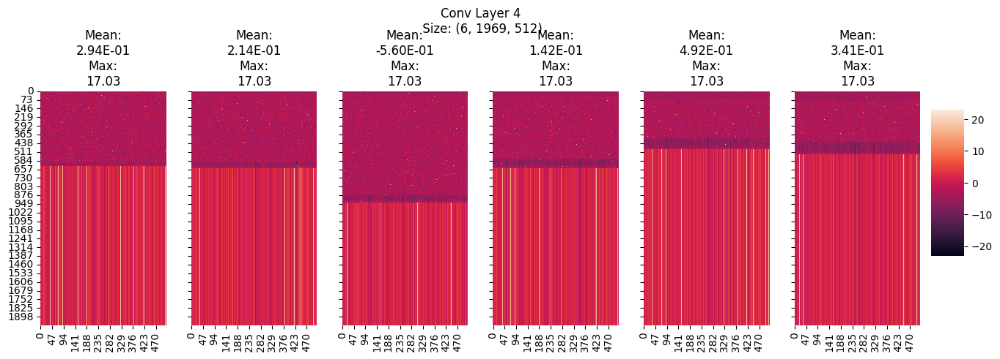

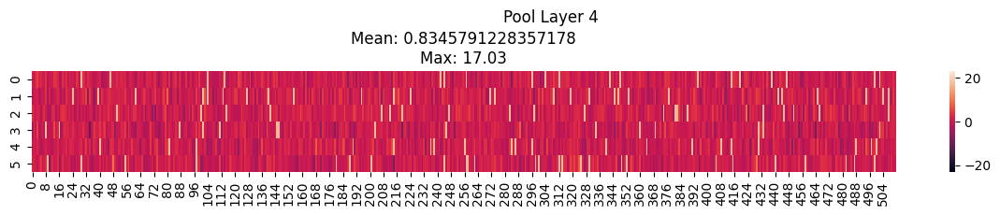

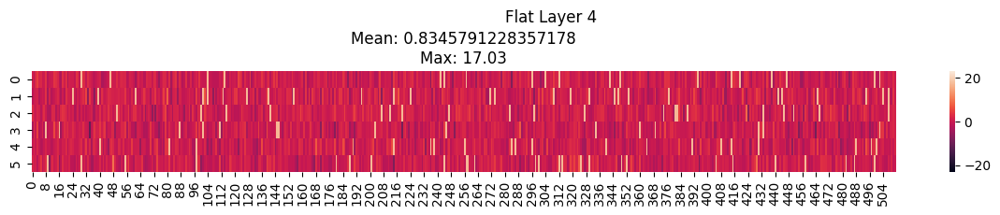

/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


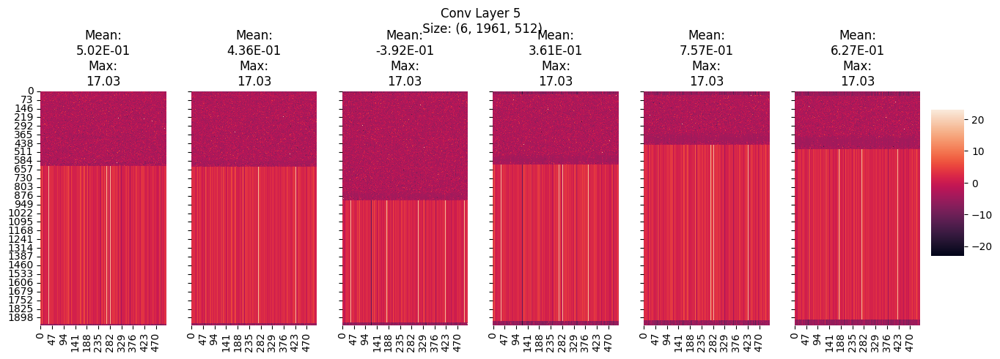

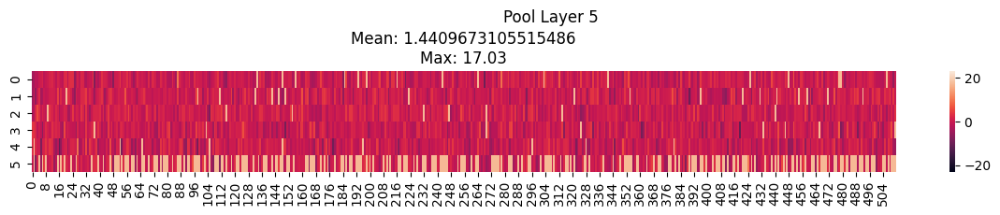

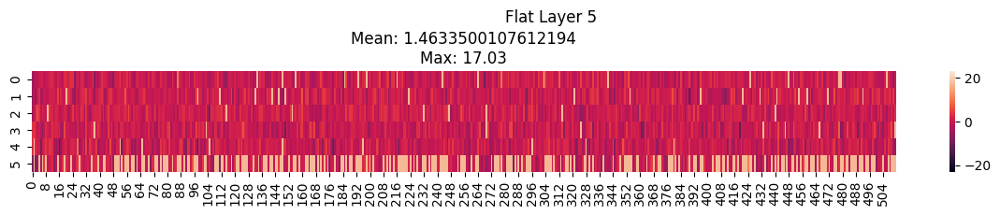

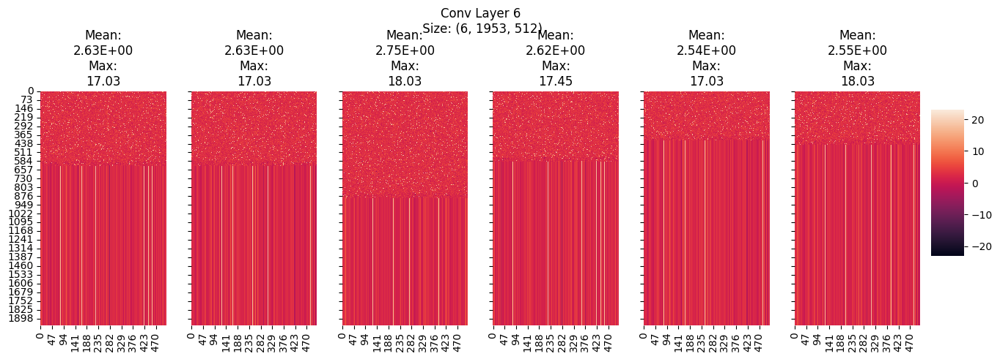

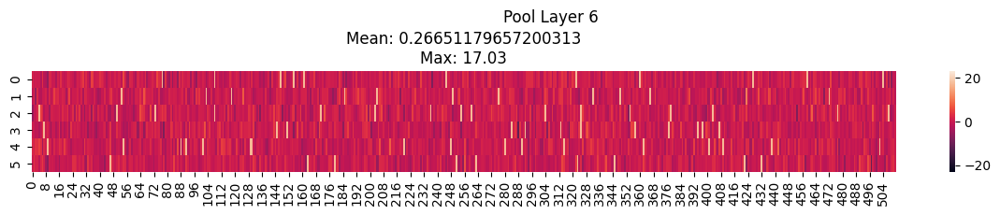

...

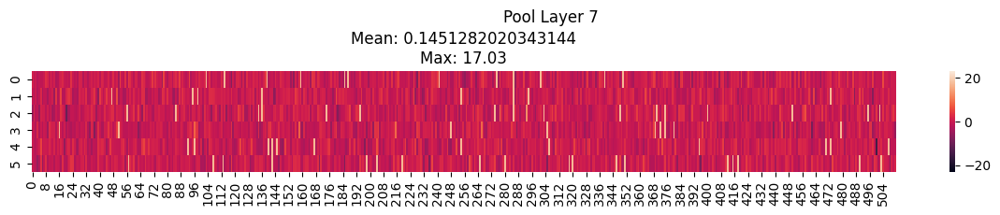

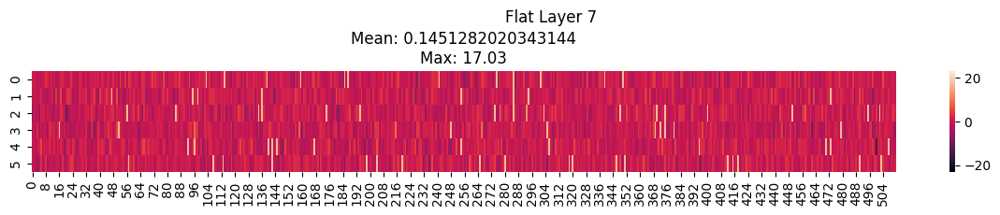

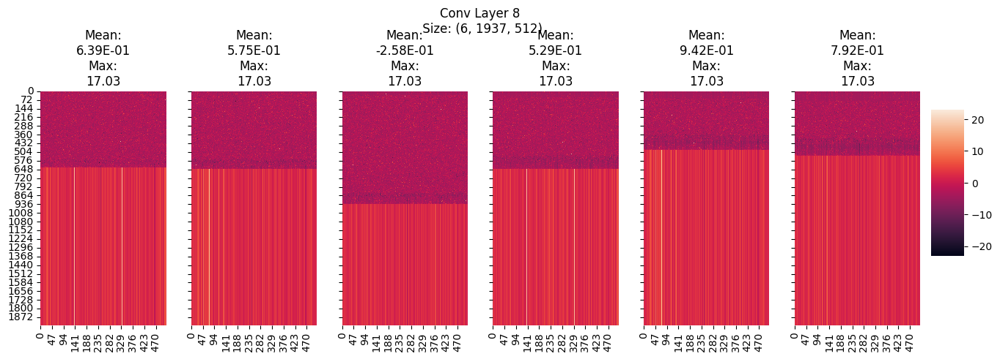

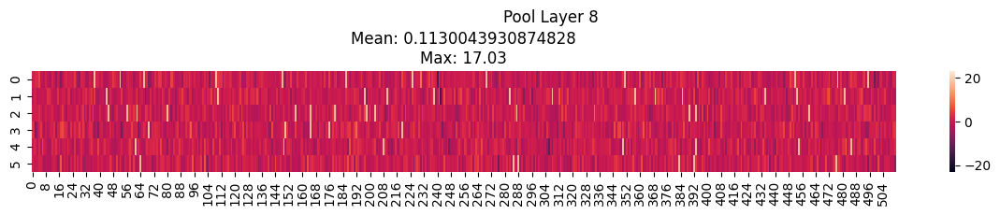

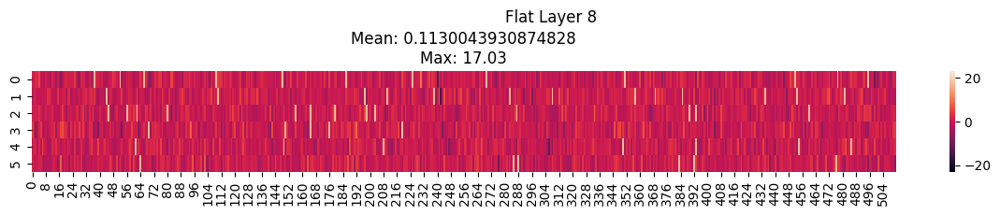

/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


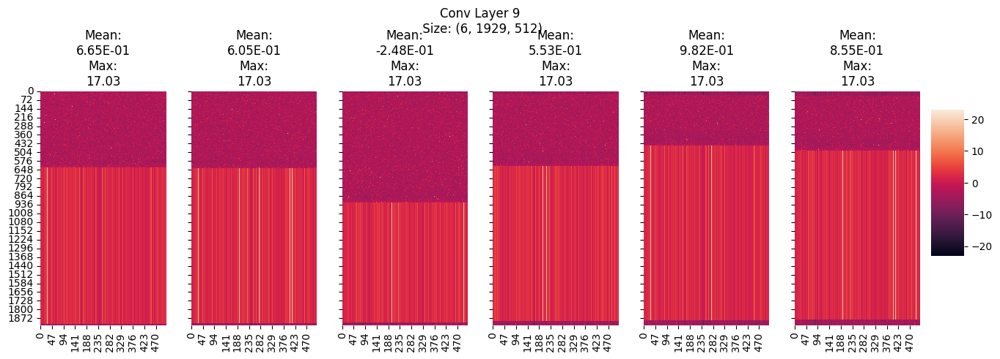

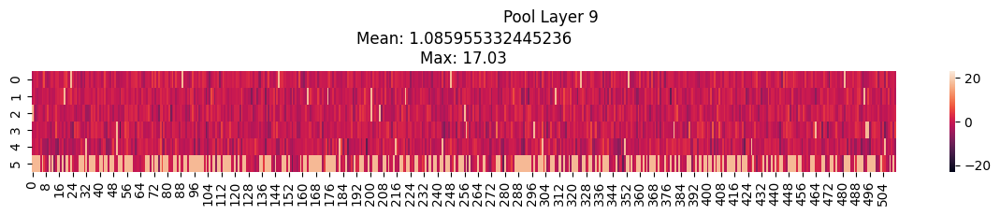

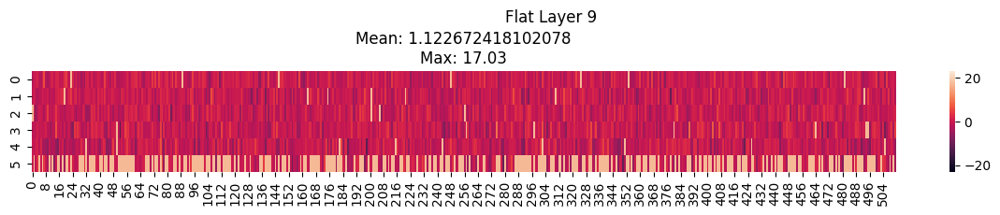

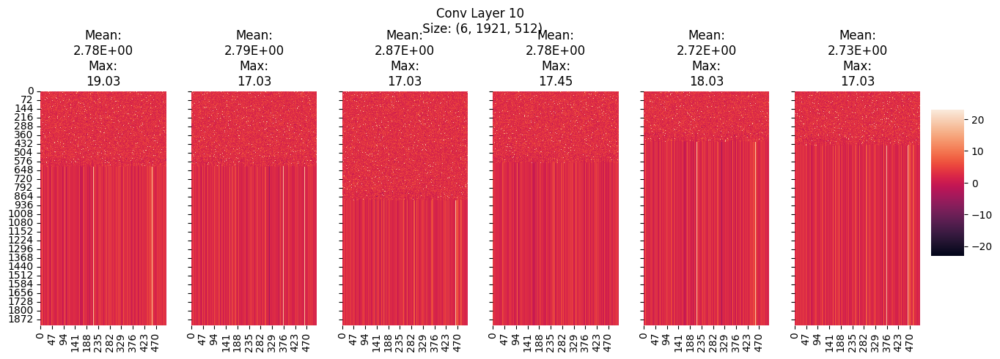

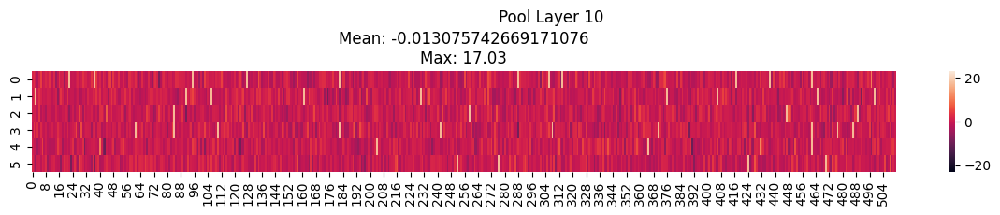

...

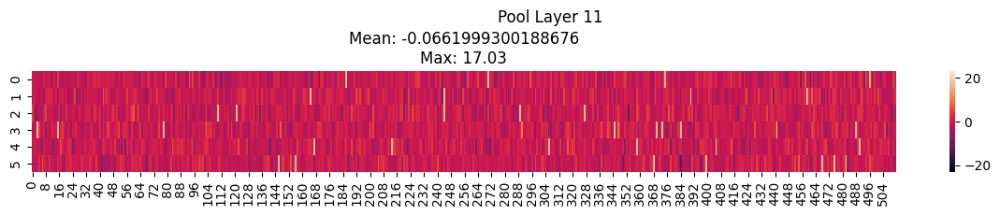

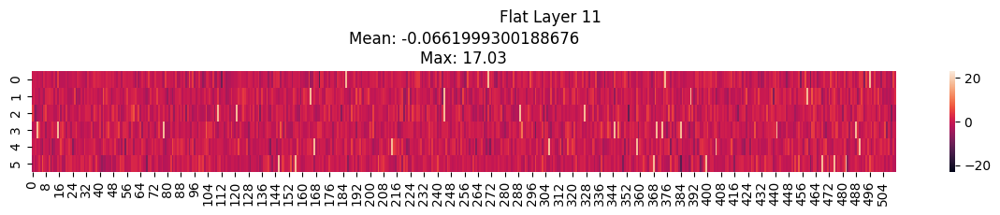

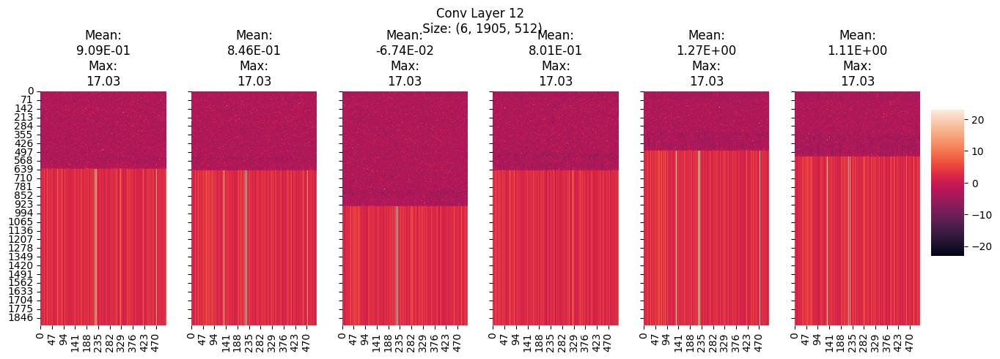

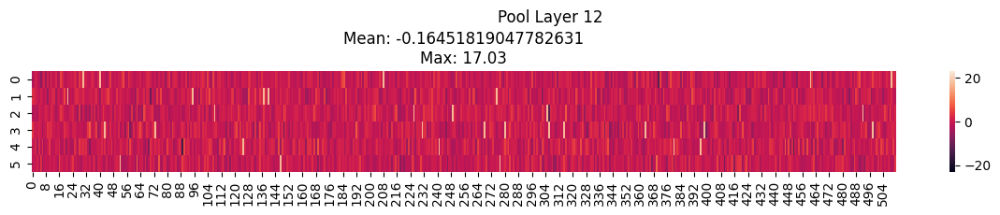

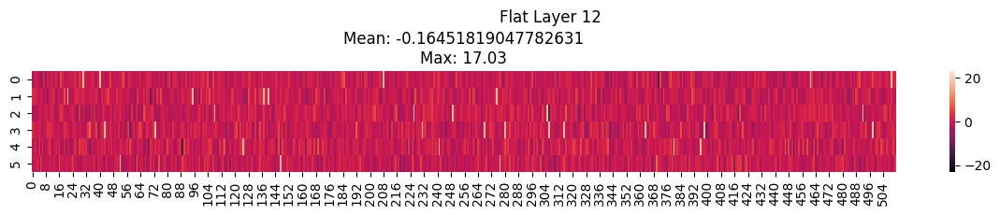

/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


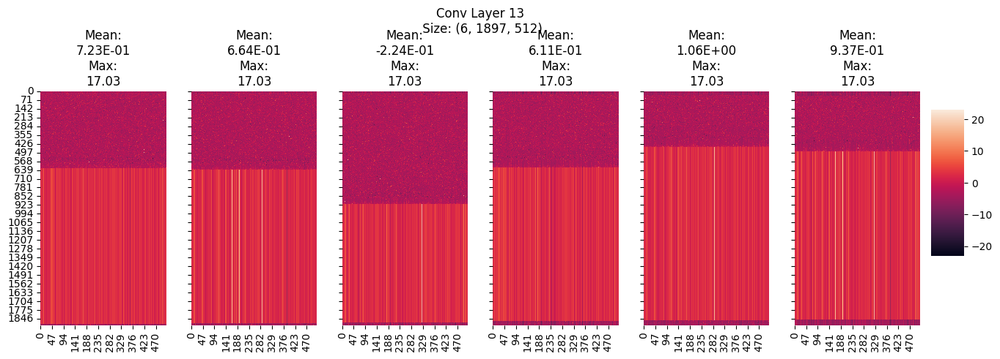

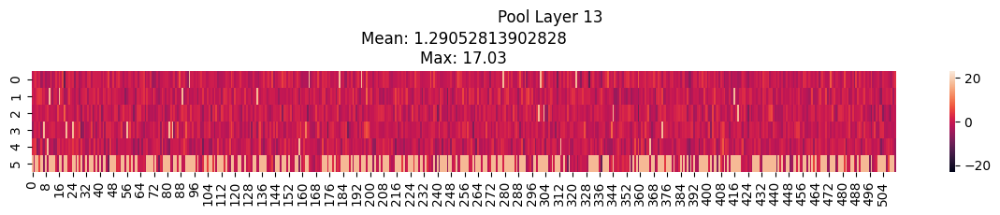

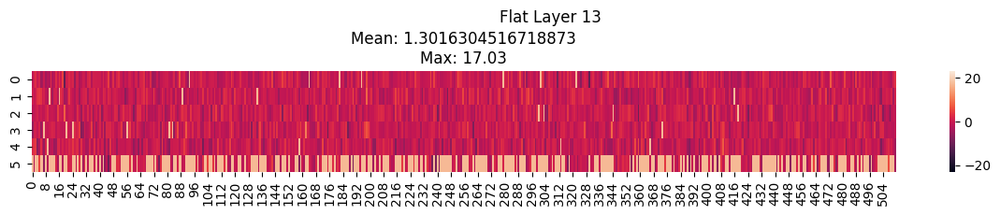

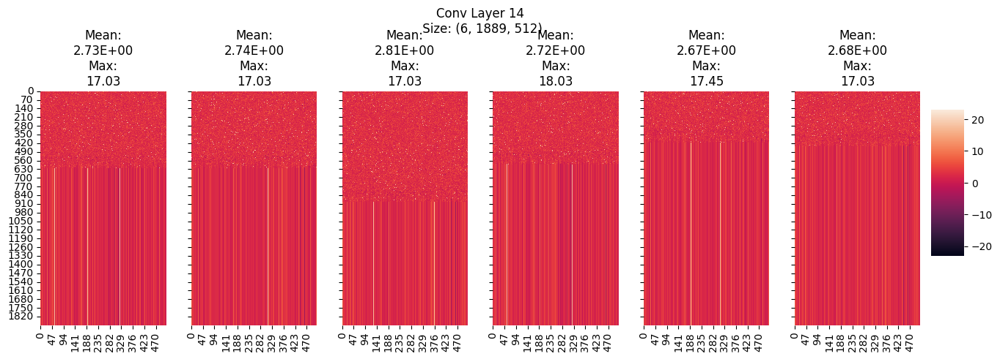

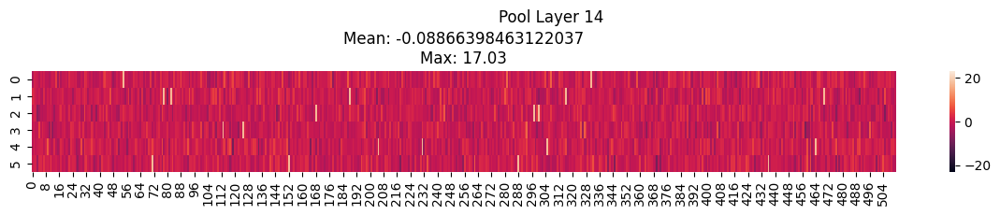

...

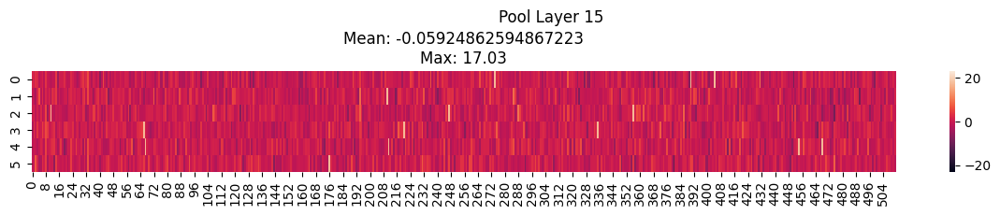

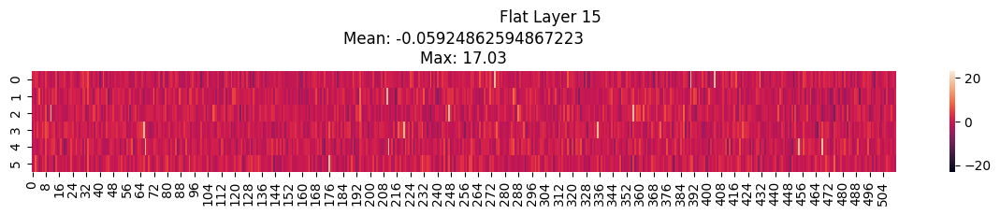

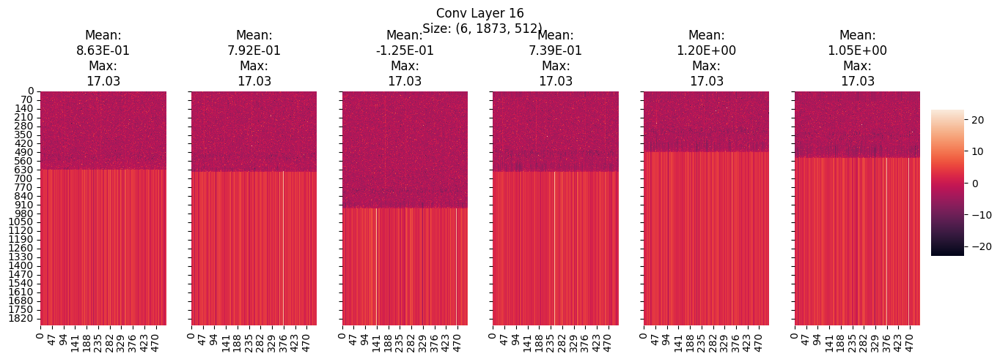

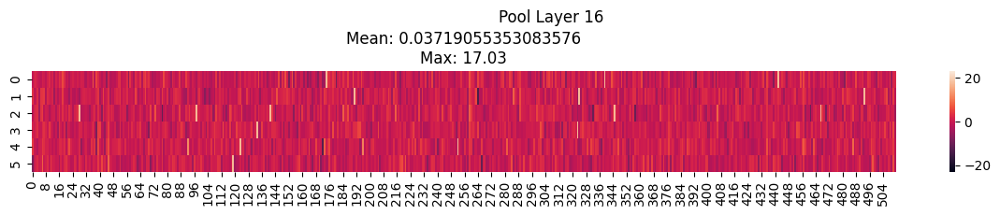

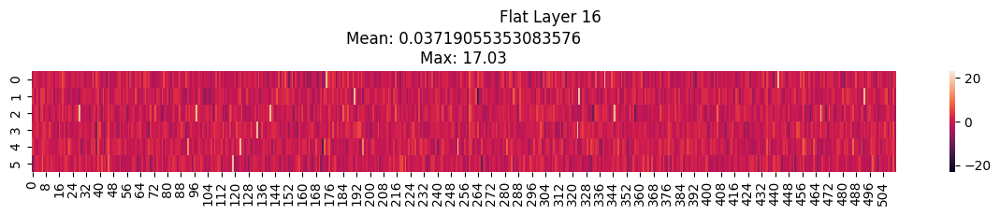

In [51]:
for layer in range(1,17):
#     pool = []
#     flat = []
    conv = pickle.load(open(f'embeddings/1_double_p23_r6_conv_{layer}_embeddings.pkl', 'rb'))[0]
    pool = pickle.load(open(f'embeddings/1_double_p23_r6_pool_{layer}_embeddings.pkl', 'rb'))[0]
    flat = pickle.load(open(f'embeddings/1_double_p23_r6flat_{layer}_embeddings.pkl', 'rb'))[0]
        
    # conv = np.array(conv)
#     pool = np.array(pool)
#     flat = np.array(flat)
    

    reduced_conv = pickle.load(open(f'embeddings/1_double_p23_r5_conv_{layer}_embeddings.pkl', 'rb'))[0]
    reduced_pool = pickle.load(open(f'embeddings/1_double_p23_r5_pool_{layer}_embeddings.pkl', 'rb'))[0]
    reduced_flat = pickle.load(open(f'embeddings/1_double_p23_r5flat_{layer}_embeddings.pkl', 'rb'))[0]
#     print(reduced_flat.shape, flat_mean.shape, flat.shape)
#     print(reduced_pool.shape, pool_mean.shape, pool.shape)
    
#     print(reduced_conv.shape, conv.shape)
    
    conv_sig = sig.significant_digits([reduced_conv, conv], reference=conv) 
    pool_sig = sig.significant_digits([reduced_pool, pool], reference=pool) 
    flat_sig = sig.significant_digits([reduced_flat, flat], reference=flat) 
    
    fig, axn = plt.subplots(1, 6, figsize=(15,5), sharex=True, sharey=True)
    cbar_ax = fig.add_axes([.91, .3, .03, .4])

    for i, ax in enumerate(axn.flat):
        sns.heatmap(data=conv_sig[i,:,:], ax=ax,
#                     cbar=True
                    cbar=i == 0,
                    vmin=-23, vmax=23,
                    cbar_ax=None if i else cbar_ax
                   )
        ax.set_title(f'Mean:\n{np.mean(conv_sig[i,:,:]):.2E}\nMax:\n{np.amax(conv_sig[i,:,:]):.2f}')

    fig.suptitle(f"Conv Layer {layer}\n Size: {conv.shape}")
    plt.subplots_adjust(top=0.75, left=.1)
    plt.show()
#     break
    
#     print(mae_pool.shape)
    fig, ax = plt.subplots(1, 1, figsize=(15,2), sharex=True, sharey=True)
#     cbar_ax = fig.add_axes([.91, .3, .03, .4])

#     for i, ax in enumerate(axn.flat):
    sns.heatmap(data=pool_sig.squeeze(), ax=ax, 
                cbar=True,
                # cbar=i == 0,
                vmin=-23, vmax=23,
                # cbar_ax=None if i else cbar_ax
               )
    ax.set_title(f'Mean: {np.mean(pool_sig)}\nMax: {np.amax(pool_sig):.2f}')

    fig.suptitle(f"Pool Layer {layer}")
    plt.subplots_adjust(top=0.65, left=.13)

    plt.show()
    
    
    
    fig, ax = plt.subplots(1, 1, figsize=(15,2), sharex=True, sharey=True)
#     cbar_ax = fig.add_axes([.91, .3, .03, .4])
    # print(mae_flat.shape)

#     for i, ax in enumerate(axn.flat):
    sns.heatmap(data=flat_sig, ax=ax, 
                cbar=True,
                # cbar=i == 0,
                vmin=-23, vmax=23,
                # cbar_ax=None if i else cbar_ax
               )
    ax.set_title(f'Mean: {np.mean(flat_sig)}\nMax: {np.amax(flat_sig):.2f}')

    fig.suptitle(f"Flat Layer {layer}")
    plt.subplots_adjust(top=0.65, left=.13)

    plt.show()

    # break
    


## General

/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


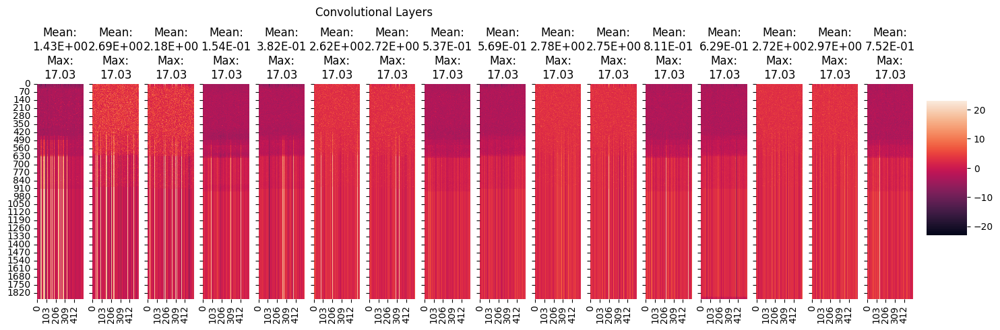

/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


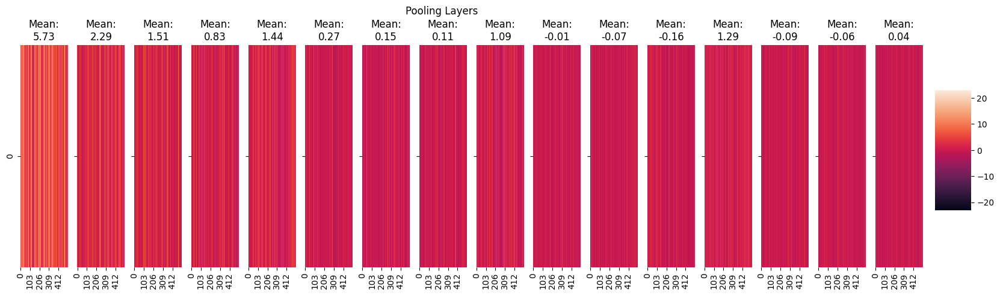

/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
/home/ines/.local/lib/python3.10/site-packages/numpy/core/_methods.py:173: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


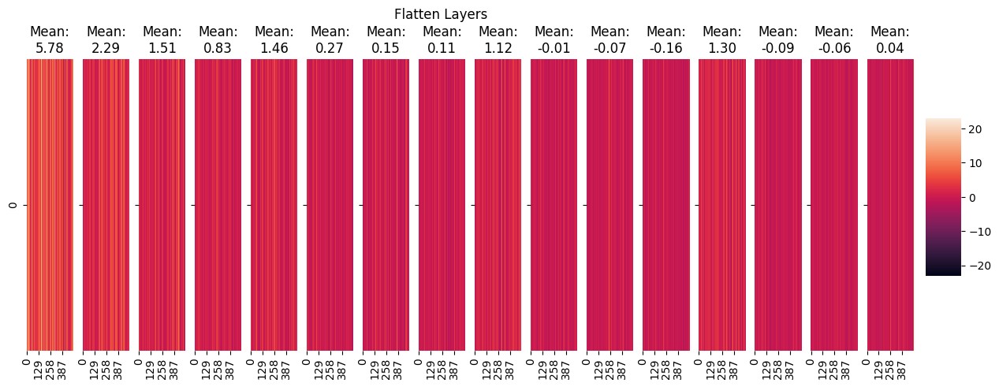

In [39]:
fig, axn = plt.subplots(1, 16, figsize=(20,5), sharex=True, sharey=True)
cbar_ax = fig.add_axes([.91, .3, .03, .4])
    
for layer, ax in enumerate(axn.flat):
# for layer in range(1,17):
#     conv = []
#     for iteration in range(1,11):
#         print(iteration, layer)
    conv = pickle.load(open(f'embeddings/1_double_p23_r6_conv_{layer+1}_embeddings.pkl', 'rb'))[0]
    
    
#     conv_mean = np.mean(conv, axis=0)


    reduced_conv = pickle.load(open(f'embeddings/1_double_p23_r5_conv_{layer+1}_embeddings.pkl', 'rb'))[0]
    
    conv_sig = sig.significant_digits([reduced_conv, conv], reference=conv)
    conv_sig = np.mean(conv_sig, axis=0)
                
    
    sns.heatmap(data=conv_sig, ax=ax,
#                 cbar=True,
                cbar=layer == 0,
                vmin=-23, vmax=23,
                cbar_ax=None if layer else cbar_ax
               )
    ax.set_title(f'Mean:\n{np.mean(conv_sig):.2E}\nMax:\n{np.amax(conv_sig):.2f}')

fig.suptitle(f"Convolutional Layers")
plt.subplots_adjust(top=0.75, left=.25)
plt.show()

    
fig, axn = plt.subplots(1, 16, figsize=(20,5), sharex=True, sharey=True)
cbar_ax = fig.add_axes([.91, .3, .03, .4])
    
for layer, ax in enumerate(axn.flat):
    
    pool = pickle.load(open(f'embeddings/1_double_p23_r6_pool_{layer+1}_embeddings.pkl', 'rb'))[0]
        
    reduced_pool = pickle.load(open(f'embeddings/1_double_p23_r5_pool_{layer+1}_embeddings.pkl', 'rb'))[0]
    
#     print(reduced_pool.shape, pool_mean.shape)
    pool_sig = sig.significant_digits([reduced_pool, pool], reference=pool)
    pool_sig = np.mean(pool_sig, axis=0)
    
    sns.heatmap(data=pool_sig, ax=ax,
#                 cbar=True,
                cbar=layer == 0,
                vmin=-23, vmax=23,
                cbar_ax=None if layer else cbar_ax
               )
    ax.set_title(f'Mean:\n{np.mean(pool_sig):.2f}')
fig.suptitle(f"Pooling Layers")
plt.subplots_adjust(top=0.85, left=.15)
plt.show()


fig, axn = plt.subplots(1, 16, figsize=(15,5), sharex=True, sharey=True)
cbar_ax = fig.add_axes([.91, .3, .03, .4])  
for layer, ax in enumerate(axn.flat):
    
    flat = pickle.load(open(f'embeddings/1_double_p23_r6flat_{layer+1}_embeddings.pkl', 'rb'))[0]
        
    reduced_flat = pickle.load(open(f'embeddings/1_double_p23_r5flat_{layer+1}_embeddings.pkl', 'rb'))[0]
#     print(reduced_flat.shape, flat_mean.shape)
    
    flat_sig = sig.significant_digits([reduced_flat, flat], reference=flat)
    flat_sig = np.mean(flat_sig, axis=0)
    # print(flat_sig.shape, )


    sns.heatmap(data=flat_sig.reshape(1,512), ax=ax,
#                 cbar=True,
                cbar=layer == 0,
                vmin=-23, vmax=23,
                cbar_ax=None if layer else cbar_ax
               )
    ax.set_title(f'Mean:\n{np.mean(flat_sig):.2f}')
fig.suptitle(f"Flatten Layers")
plt.subplots_adjust(top=0.85, left=.15)
plt.show()

## Relative Error
* Is actual value correct?

## Reduced Range

### Specific

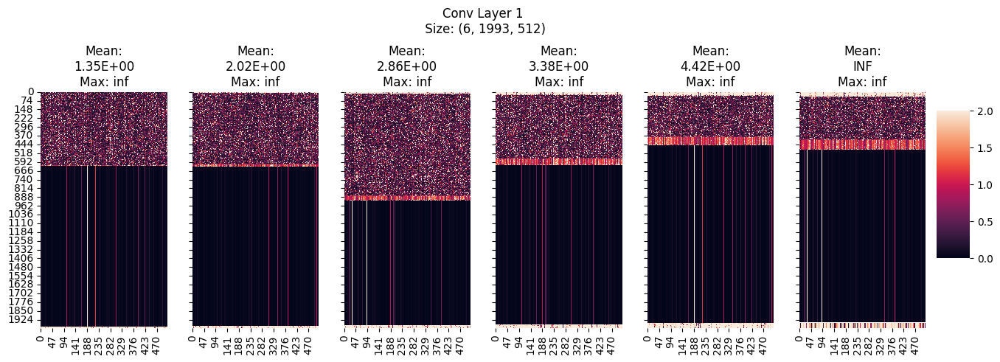

(6, 1, 512)


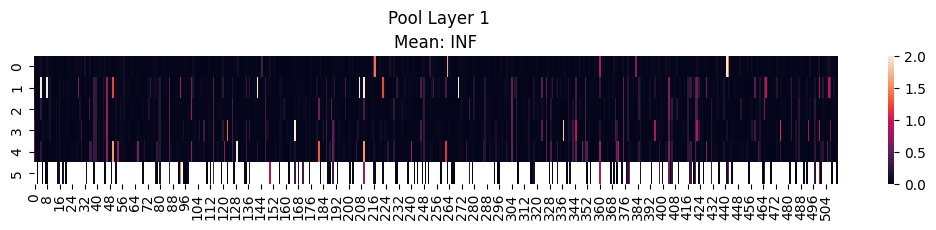

(6, 512)


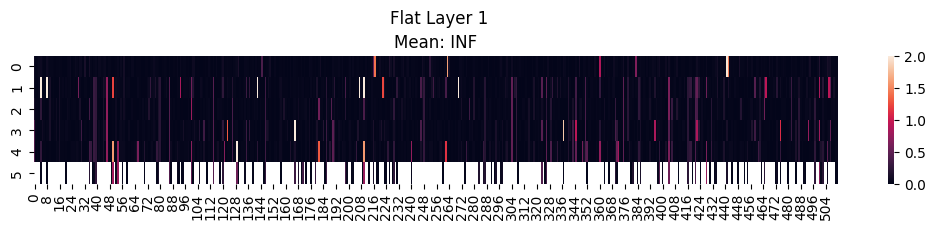

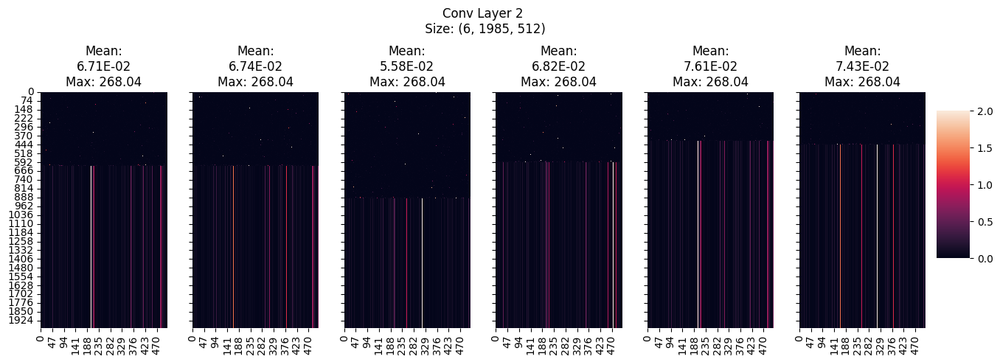

(6, 1, 512)


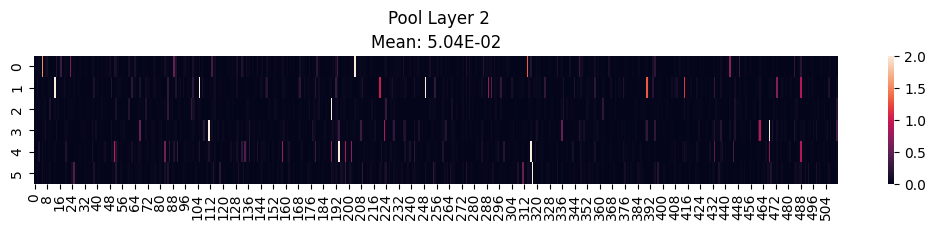

(6, 512)


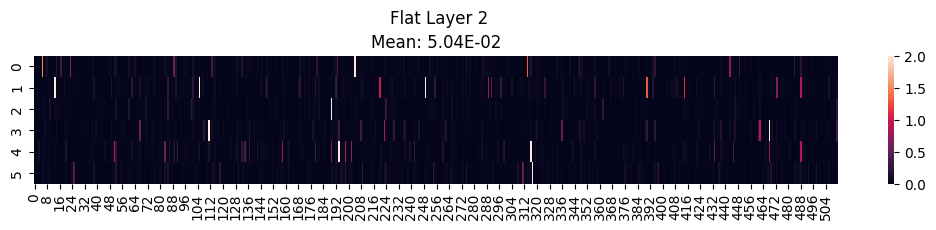

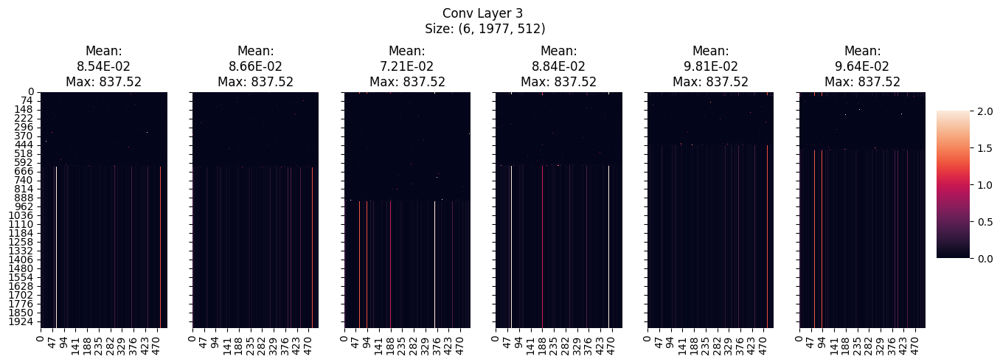

(6, 1, 512)


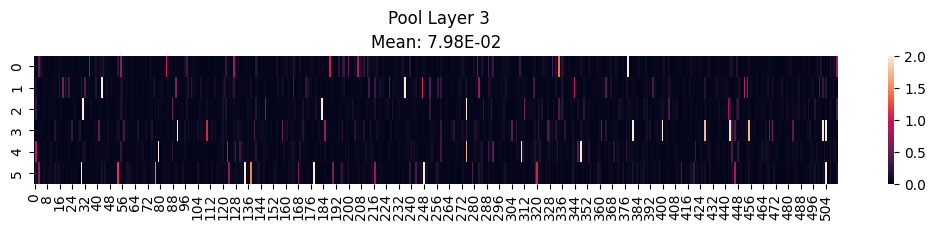

(6, 512)


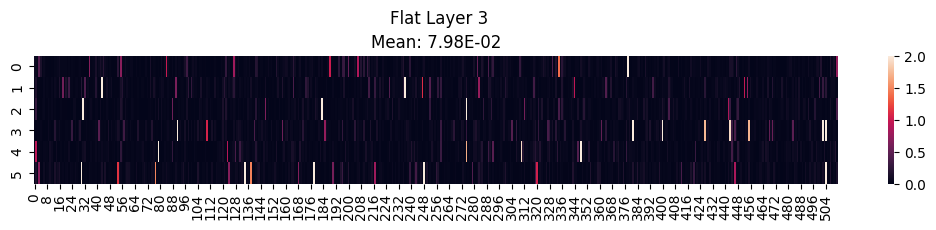

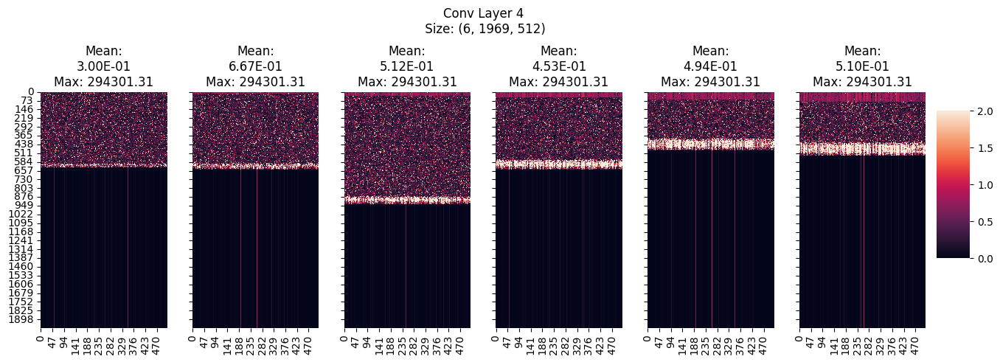

(6, 1, 512)


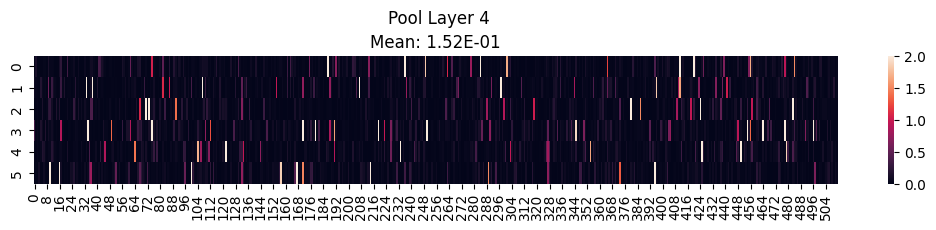

(6, 512)


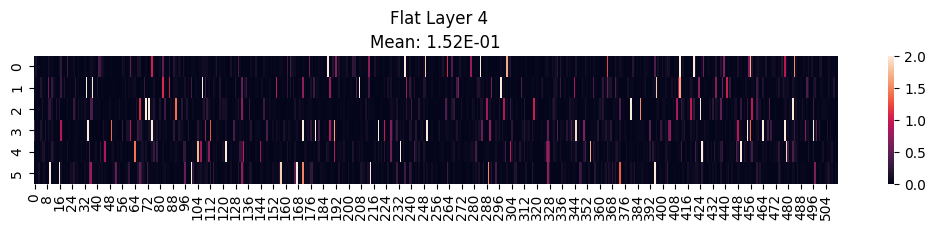

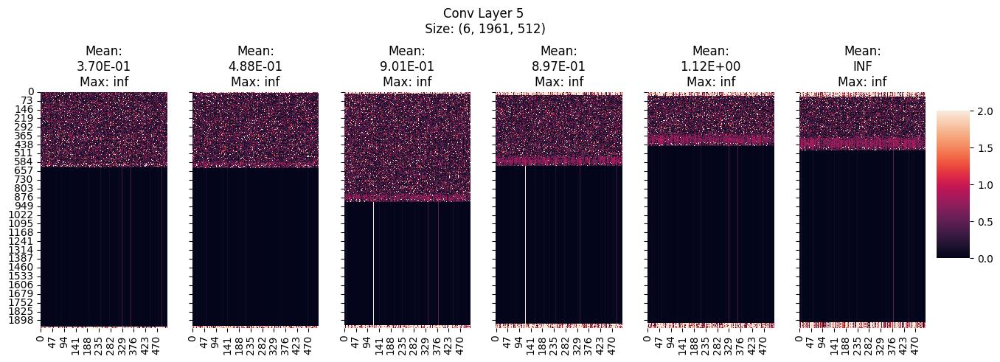

(6, 1, 512)


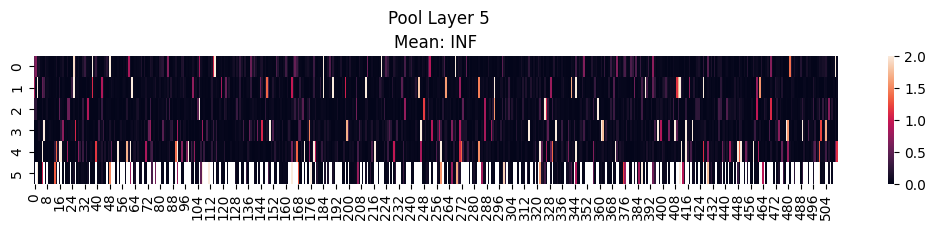

(6, 512)


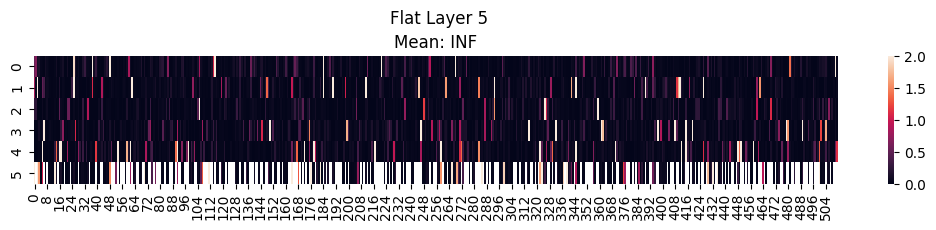

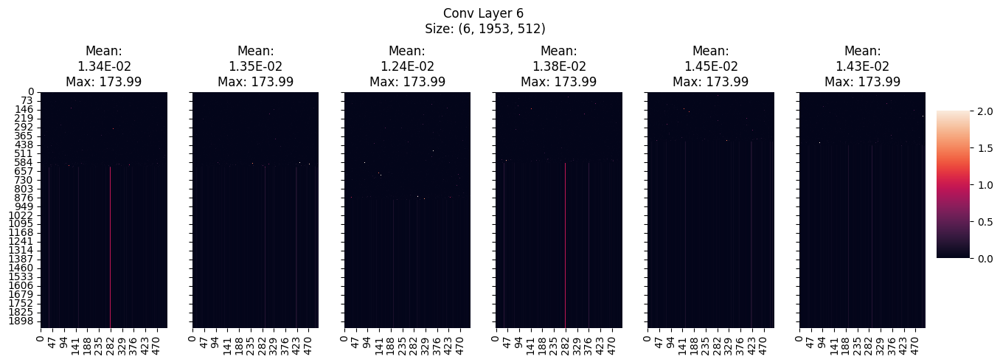

(6, 1, 512)


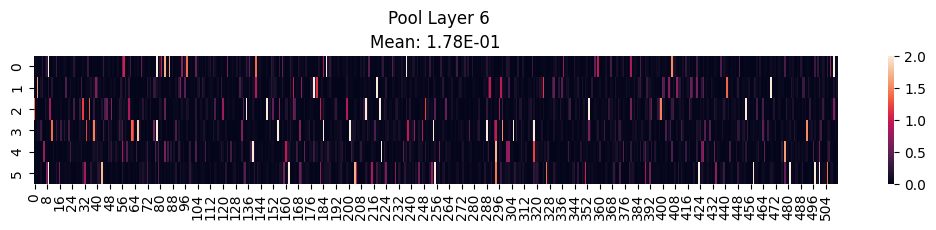

(6, 512)


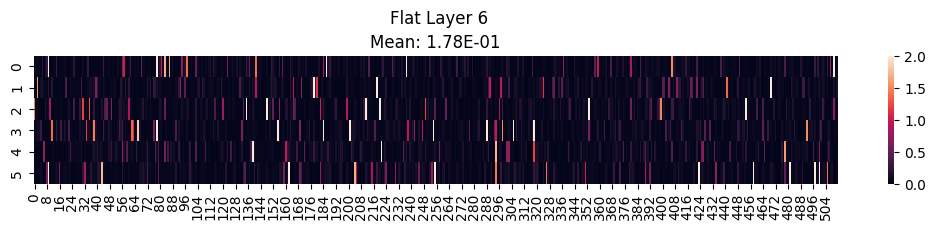

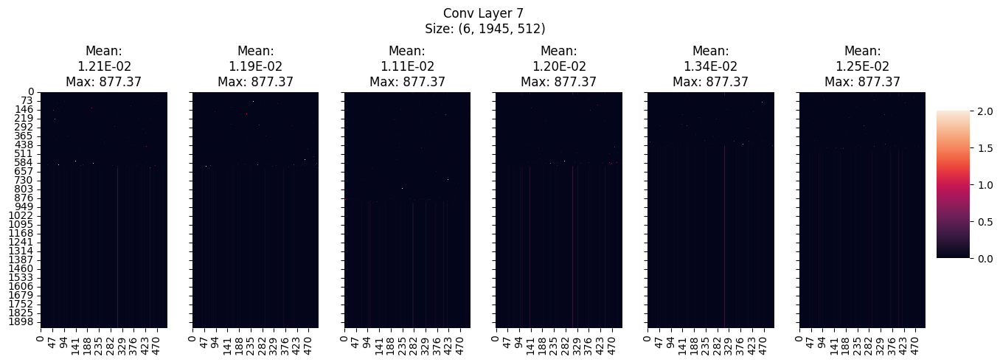

(6, 1, 512)


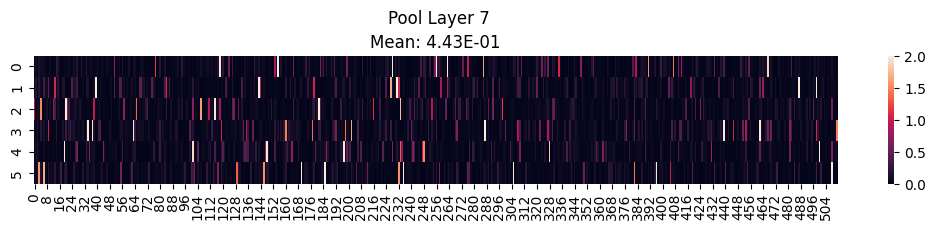

(6, 512)


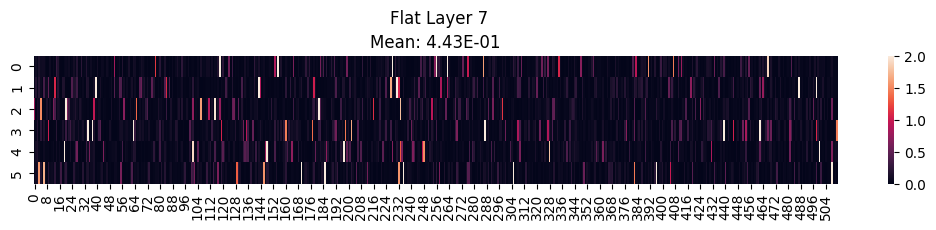

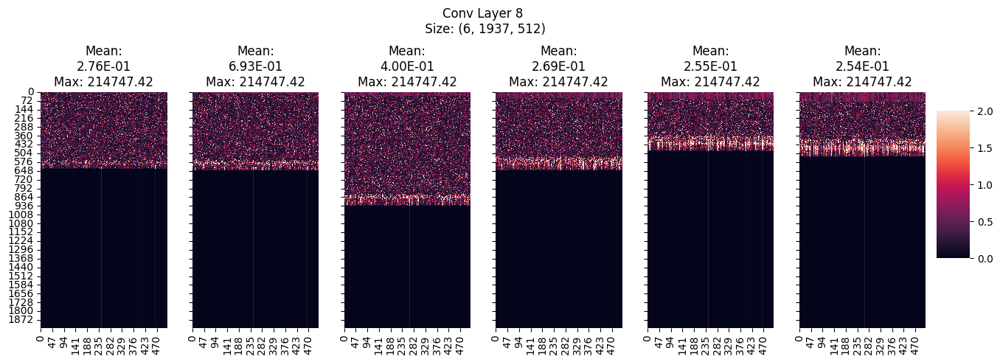

(6, 1, 512)


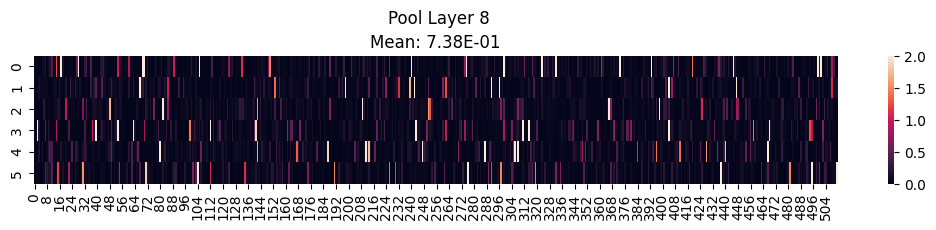

(6, 512)


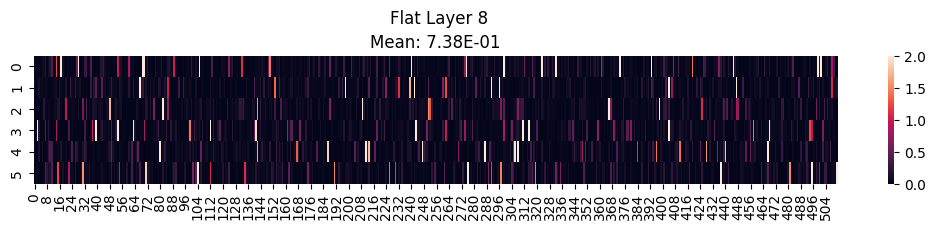

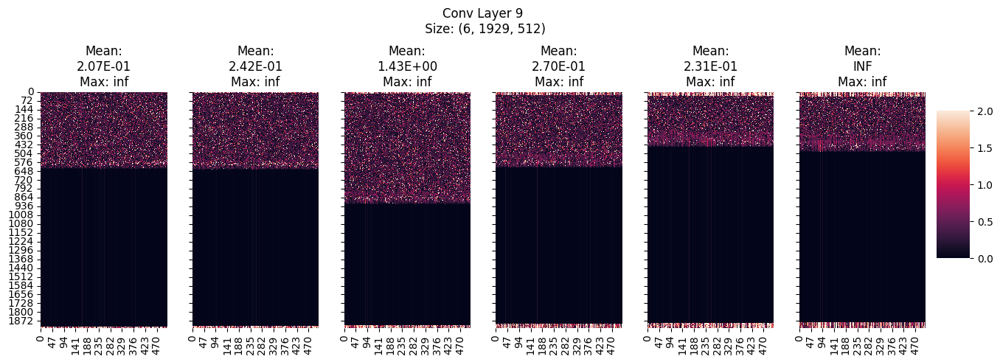

(6, 1, 512)


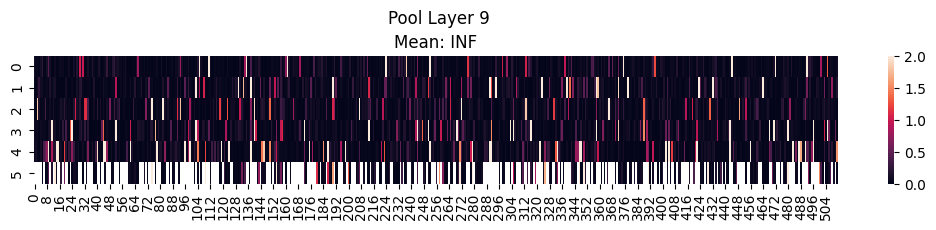

(6, 512)


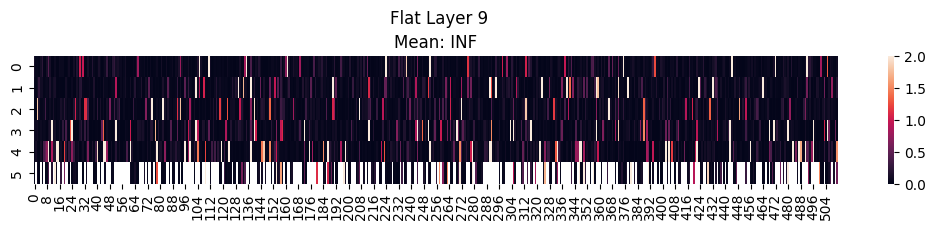

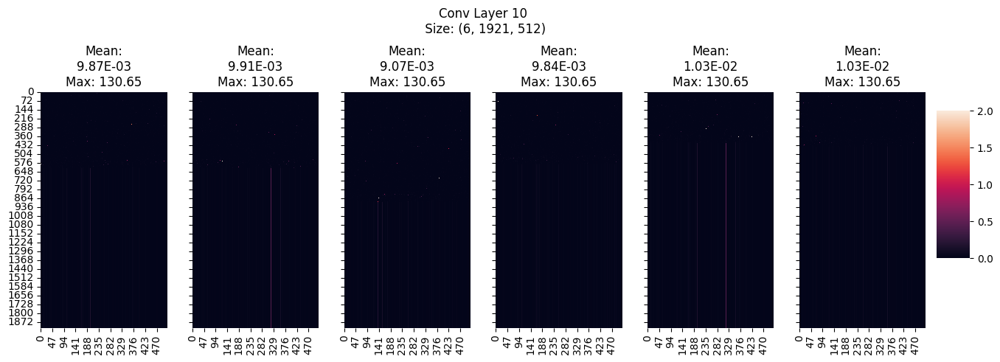

(6, 1, 512)


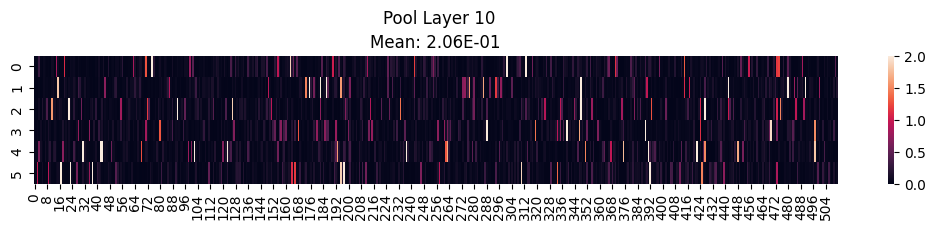

(6, 512)


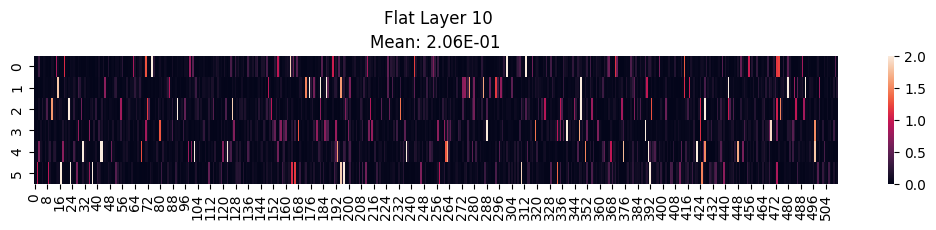

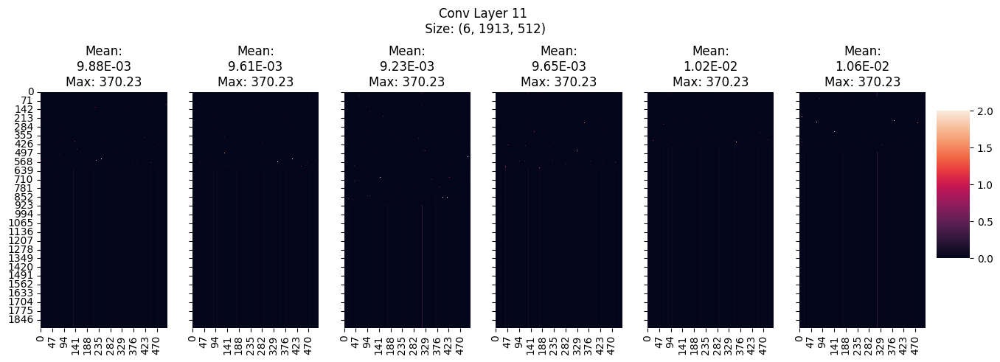

(6, 1, 512)


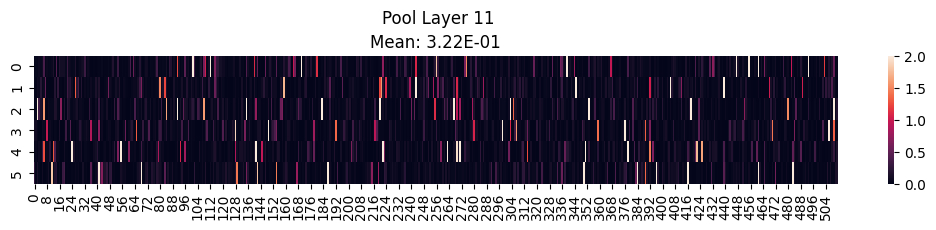

(6, 512)


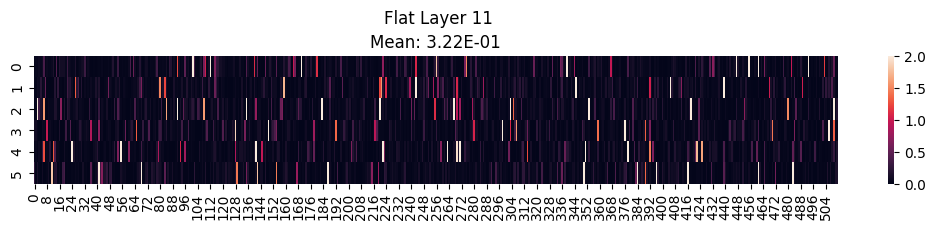

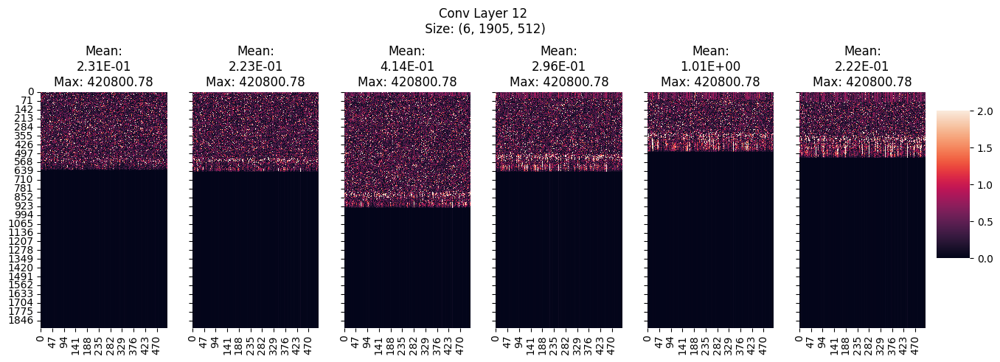

(6, 1, 512)


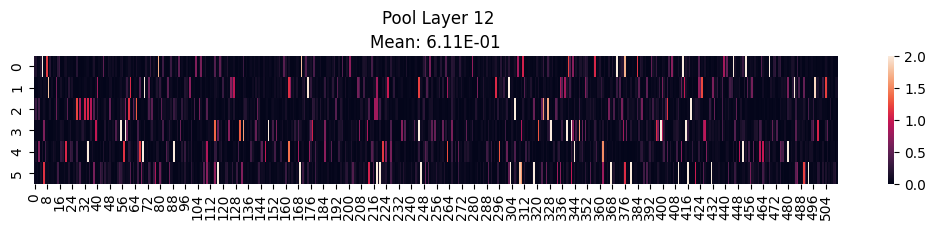

(6, 512)


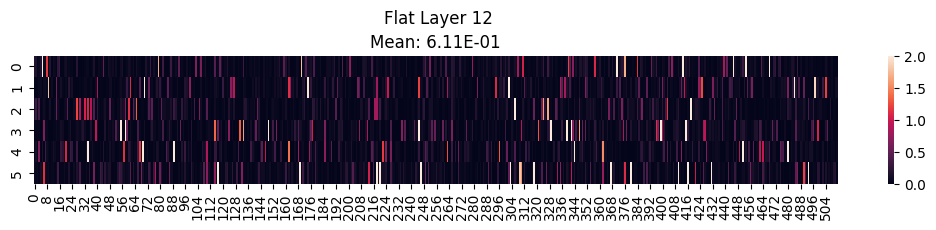

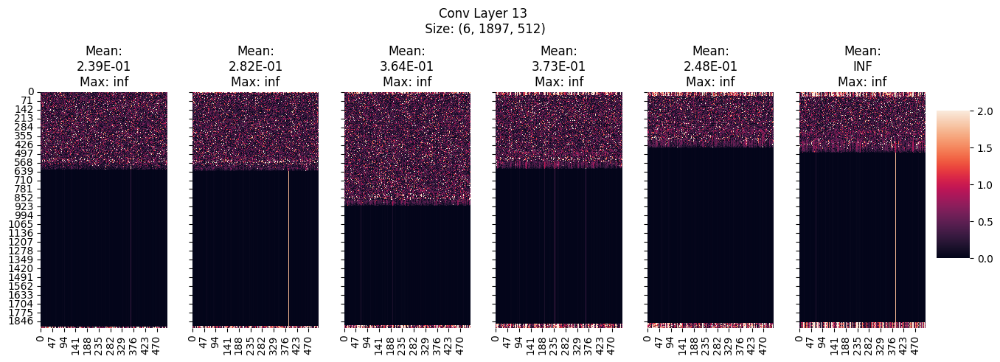

(6, 1, 512)


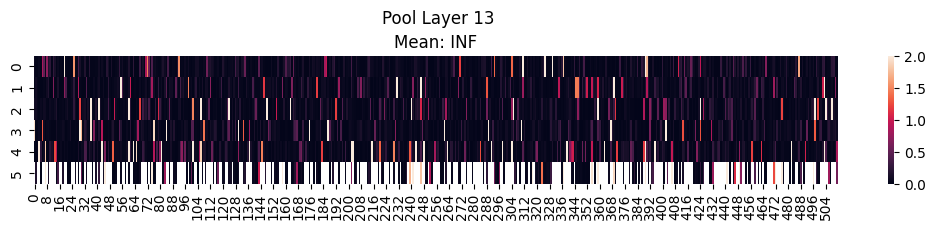

(6, 512)


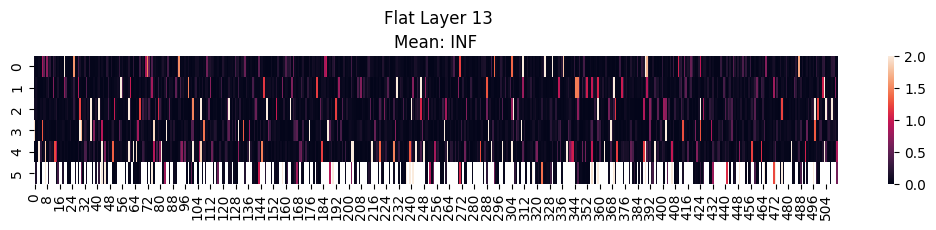

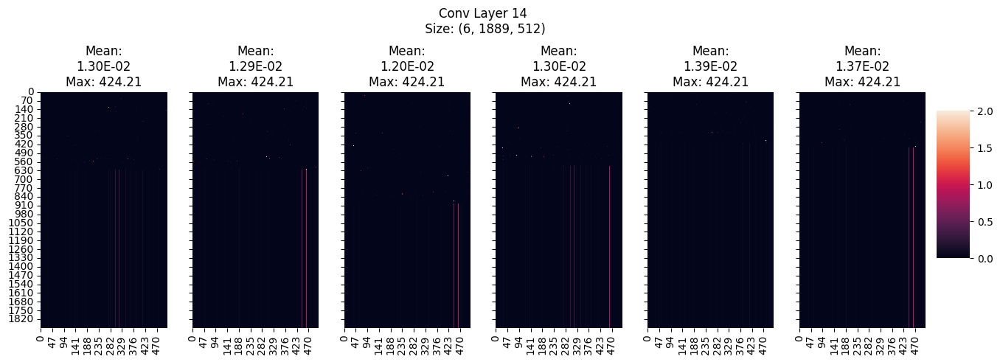

(6, 1, 512)


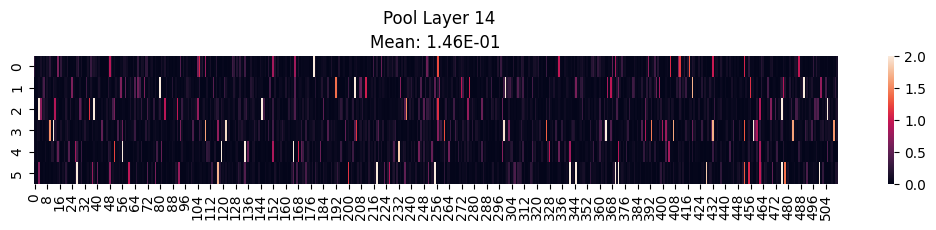

(6, 512)


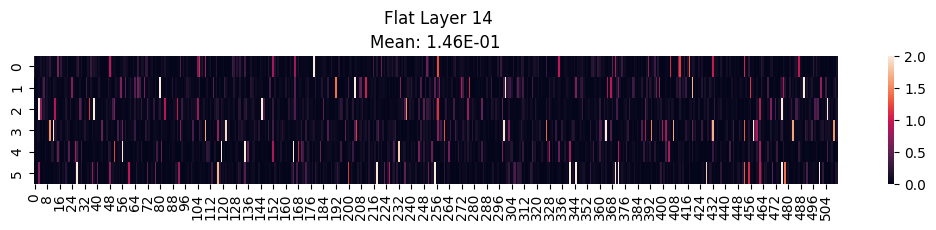

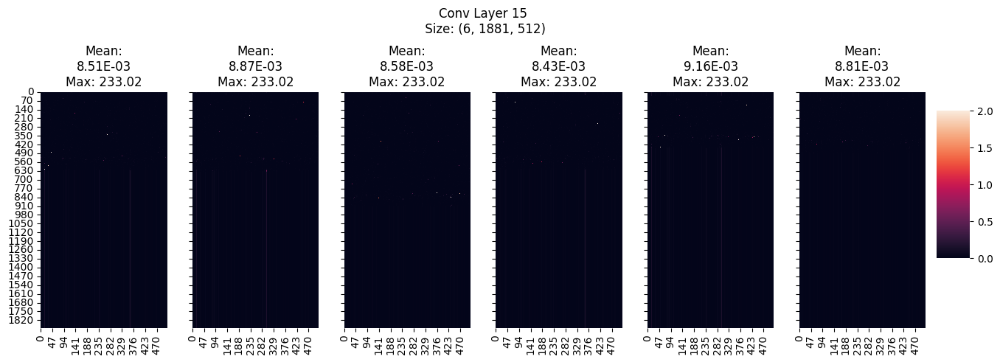

(6, 1, 512)


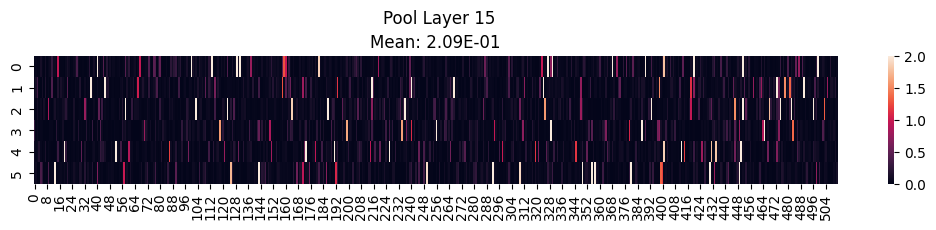

(6, 512)


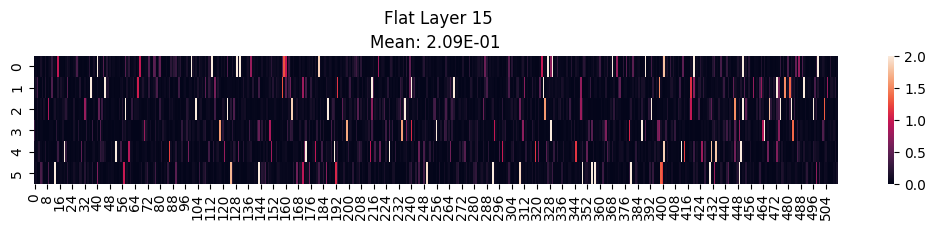

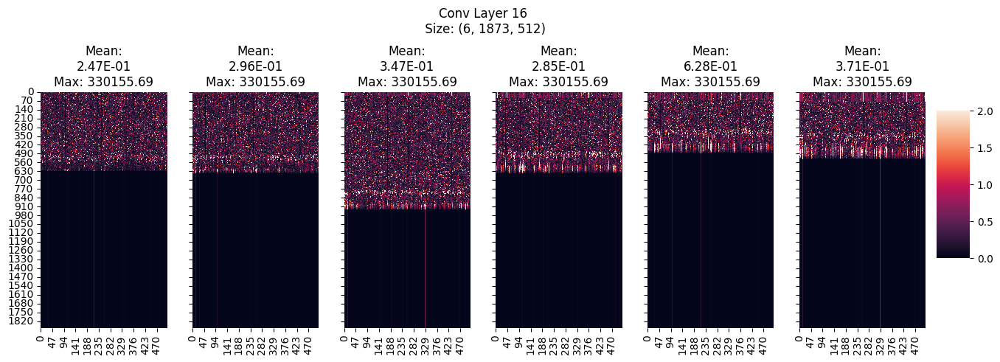

(6, 1, 512)


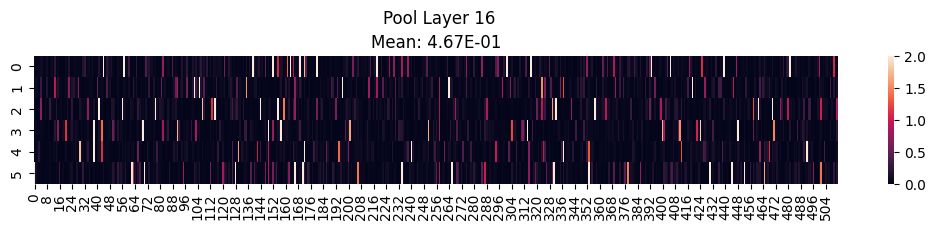

(6, 512)


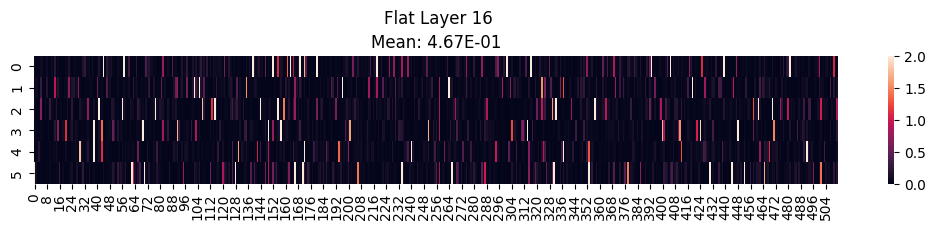

In [32]:
def absolute_error(actual, predicted):
    return np.abs(np.array(actual) - np.array(predicted))


for layer in range(1,17):
    conv = pickle.load(open(f'embeddings/1_double_p23_r6_conv_{layer}_embeddings.pkl', 'rb'))[0]
#         print(s.shape)
#         conv.append(s)
    pool = pickle.load(open(f'embeddings/1_double_p23_r6_pool_{layer}_embeddings.pkl', 'rb'))[0]
    flat = pickle.load(open(f'embeddings/1_double_p23_r6flat_{layer}_embeddings.pkl', 'rb'))[0]
        
    # conv = np.array(conv)
#     pool = np.array(pool)
#     flat = np.array(flat)
    
#     conv_mean = np.mean(conv, axis=0)
#     pool_mean = np.mean(pool, axis=0)
#     flat_mean = np.mean(flat, axis=0)

    reduced_conv = pickle.load(open(f'embeddings/1_double_p23_r5_conv_{layer}_embeddings.pkl', 'rb'))[0]
    reduced_pool = pickle.load(open(f'embeddings/1_double_p23_r5_pool_{layer}_embeddings.pkl', 'rb'))[0]
    reduced_flat = pickle.load(open(f'embeddings/1_double_p23_r5flat_{layer}_embeddings.pkl', 'rb'))[0]
#     print(reduced_flat.shape, flat_mean.shape, flat.shape)
#     print(reduced_pool.shape, pool_mean.shape, pool.shape)
    
#     print(reduced_conv.shape, conv.shape)
    
    tmp_conv = absolute_error(conv,  reduced_conv) 
    tmp_pool = absolute_error(pool,  reduced_pool) 
    tmp_flat = absolute_error(flat,  reduced_flat) 

#     break
    mae_conv = np.abs(tmp_conv / conv)
    mae_pool = np.abs(tmp_pool / pool)
    mae_flat = np.abs(tmp_flat / flat)


    fig, axn = plt.subplots(1, 6, figsize=(15,5), sharex=True, sharey=True)
    cbar_ax = fig.add_axes([.91, .3, .03, .4])

    for i, ax in enumerate(axn.flat):
        sns.heatmap(data=mae_conv[i,:,:], ax=ax,
#                     cbar=True,
                    cbar=i == 0,
                    vmin=0., vmax=2.,
                    cbar_ax=None if i else cbar_ax
                   )
        ax.set_title(f'Mean:\n{np.mean(mae_conv[i,:,:]):.2E}\nMax: {np.amax(mae_conv):.2f}')

    fig.suptitle(f"Conv Layer {layer}\n Size: {conv.shape}")
    plt.subplots_adjust(top=0.75, left=.1)
    plt.show()
#     break
    
    print(mae_pool.shape)
    fig, ax = plt.subplots(1, 1, figsize=(15,2), sharex=True, sharey=True)
#     cbar_ax = fig.add_axes([.91, .3, .03, .4])

    # for i, ax in enumerate(axn.flat):
    sns.heatmap(data=mae_pool.squeeze(), ax=ax, 
                cbar=True,
                # cbar=i == 0,
                vmin=0., vmax=2.,
                # cbar_ax=None if i else cbar_ax
               )
    ax.set_title(f'Mean: {np.mean(mae_pool):.2E}')

    fig.suptitle(f"Pool Layer {layer}")
    plt.subplots_adjust(top=0.75, left=.23)

    plt.show()
    
    
    
    fig, ax = plt.subplots(1, 1, figsize=(15,2), sharex=True, sharey=True)
#     cbar_ax = fig.add_axes([.91, .3, .03, .4])
    print(mae_flat.shape)

    # for i, ax in enumerate(axn.flat):
    sns.heatmap(data=mae_flat, ax=ax, 
                cbar=True,
                # cbar=i == 0,
                vmin=0., vmax=2.,
                # cbar_ax=None if i else cbar_ax
               )
    ax.set_title(f'Mean: {np.mean(mae_flat):.2E}')

    fig.suptitle(f"Flat Layer {layer}")
    plt.subplots_adjust(top=0.75, left=.23)

    plt.show()
    # break
   


### General

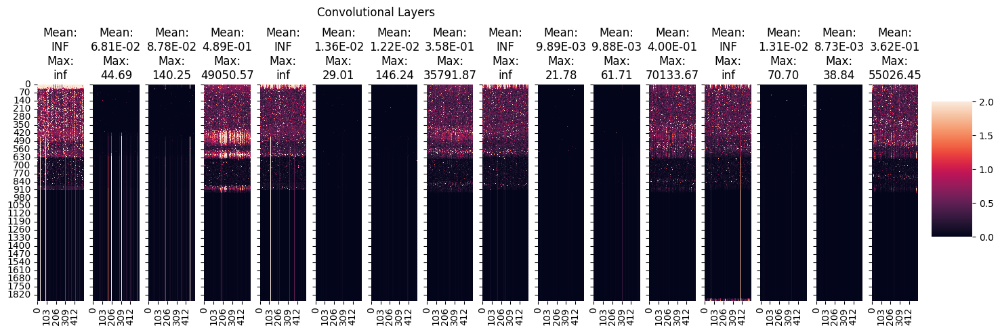

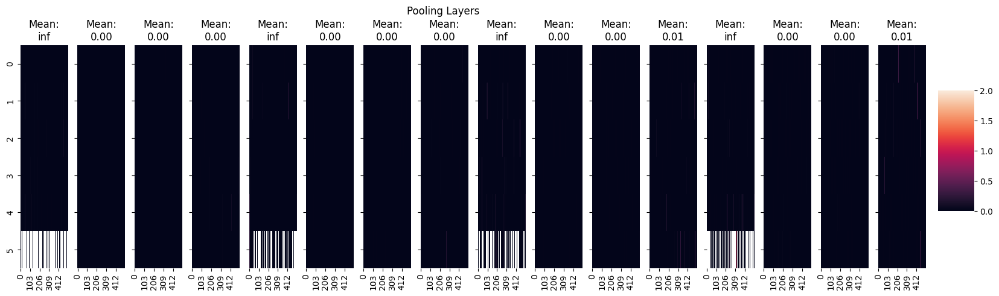

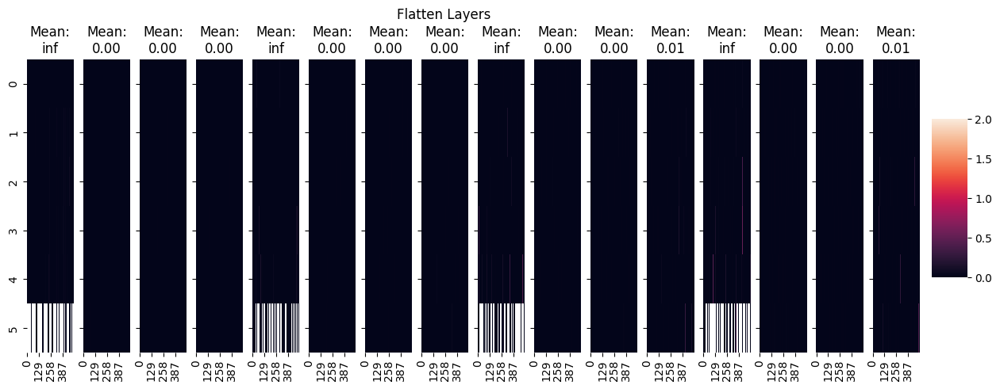

In [23]:
def absolute_error(actual, predicted):
    return np.abs(np.array(actual) - np.array(predicted))

fig, axn = plt.subplots(1, 16, figsize=(20,5), sharex=True, sharey=True)
cbar_ax = fig.add_axes([.91, .3, .03, .4])
    
for layer, ax in enumerate(axn.flat):
# for layer in range(1,17):
#     conv = []
#     for iteration in range(1,11):
#         print(iteration, layer)
    conv = pickle.load(open(f'embeddings/1_double_p23_r6_conv_{layer+1}_embeddings.pkl', 'rb'))[0]
    
    
#     conv_mean = np.mean(conv, axis=0)


    reduced_conv = pickle.load(open(f'embeddings/1_double_p23_r5_conv_{layer+1}_embeddings.pkl', 'rb'))[0]
    
    tmp = absolute_error(conv, reduced_conv)
    
    
    mae_conv = np.mean(np.abs(tmp / conv), axis=0)
                
    
    sns.heatmap(data=mae_conv, ax=ax,
#                 cbar=True,
                cbar=layer == 0,
                vmin=0, vmax=2,
                cbar_ax=None if layer else cbar_ax
               )
    ax.set_title(f'Mean:\n{np.mean(mae_conv):.2E}\nMax:\n{np.amax(mae_conv):.2f}')

fig.suptitle(f"Convolutional Layers")
plt.subplots_adjust(top=0.75, left=.25)
plt.show()

    
fig, axn = plt.subplots(1, 16, figsize=(20,5), sharex=True, sharey=True)
cbar_ax = fig.add_axes([.91, .3, .03, .4])
    
for layer, ax in enumerate(axn.flat):
    
    pool = pickle.load(open(f'embeddings/1_double_p23_r6_pool_{layer+1}_embeddings.pkl', 'rb'))[0]
        
    # pool = np.array(pool)    
    # pool_mean = np.mean(pool, axis=0)

    reduced_pool = pickle.load(open(f'embeddings/1_double_p23_r5_pool_{layer+1}_embeddings.pkl', 'rb'))[0]
    
#     print(reduced_pool.shape, pool_mean.shape)
    mae_pool = absolute_error(pool, reduced_pool)
    
#     mae_pool = np.mean(mae_pool, axis=0)

    
    sns.heatmap(data=mae_pool.squeeze(), ax=ax,
                # cbar=True,
                cbar=layer == 0,
                vmin=0, vmax=2.,
                cbar_ax=None if layer else cbar_ax
               )
    ax.set_title(f'Mean:\n{np.mean(mae_pool):.2f}')
fig.suptitle(f"Pooling Layers")
plt.subplots_adjust(top=0.85, left=.15)
plt.show()


fig, axn = plt.subplots(1, 16, figsize=(15,5), sharex=True, sharey=True)
cbar_ax = fig.add_axes([.91, .3, .03, .4])  
for layer, ax in enumerate(axn.flat):
    
    flat = pickle.load(open(f'embeddings/1_double_p23_r6flat_{layer+1}_embeddings.pkl', 'rb'))[0]
        
    # flat = np.array(flat)
    
    # flat_mean = np.mean(flat, axis=0)

    reduced_flat = pickle.load(open(f'embeddings/1_double_p23_r5flat_{layer+1}_embeddings.pkl', 'rb'))[0]
#     print(reduced_flat.shape, flat_mean.shape)
    
    mae_flat = absolute_error(flat, reduced_flat)
    
#     mae_flat = np.mean(mae_flat, axis=0)

    sns.heatmap(data=mae_flat, ax=ax,
#                 cbar=True,
                cbar=layer == 0,
                vmin=0, vmax=2.,
                cbar_ax=None if layer else cbar_ax
               )
    ax.set_title(f'Mean:\n{np.mean(mae_flat):.2f}')
fig.suptitle(f"Flatten Layers")
plt.subplots_adjust(top=0.85, left=.15)
plt.show()

(5862,)


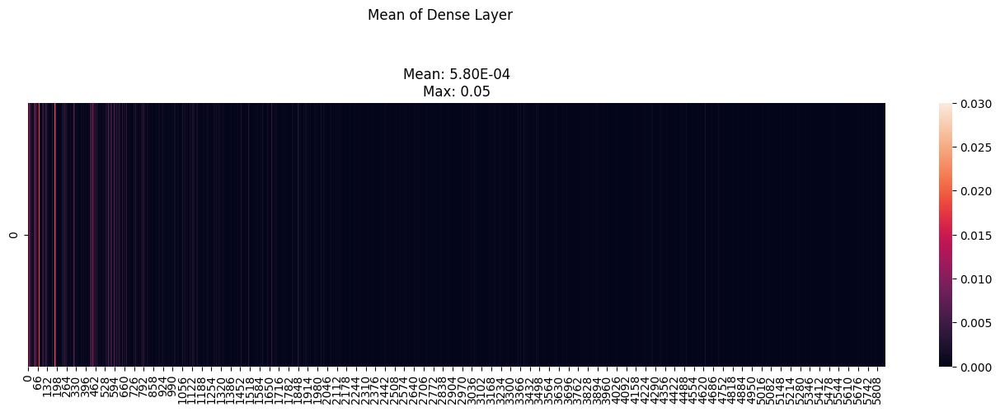

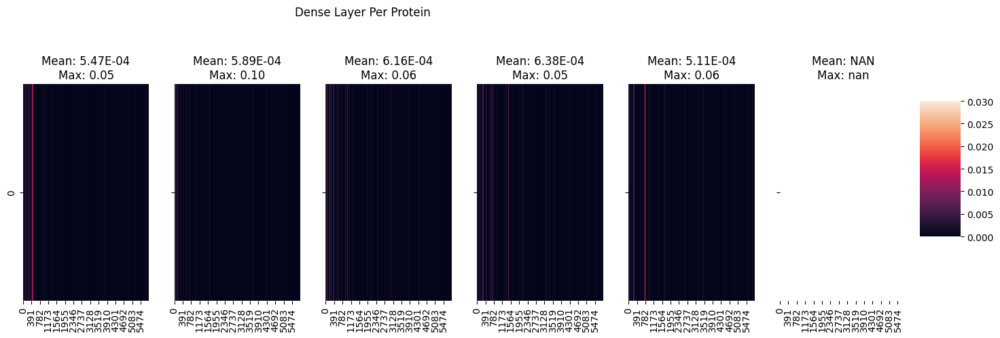

In [165]:
def absolute_error(actual, predicted):
    return np.abs(np.array(actual) - np.array(predicted))

fig, ax = plt.subplots(1, 1, figsize=(20,5), sharex=True, sharey=True)
# cbar_ax = fig.add_axes([.91, .3, .03, .4])

conv = pickle.load(open(f'embeddings/1_double_p23_r6__dense_embeddings.pkl', 'rb'))[0]

reduced_conv = pickle.load(open(f'embeddings/1_double_p23_r5__dense_embeddings.pkl', 'rb'))[0]

mae_conv = absolute_error(conv, reduced_conv)
# break
mae_conv = np.nanmean(mae_conv, axis=0)
print(mae_conv.shape)
# mae_conv[np.isnan(mae_conv)] = 0.1
           

sns.heatmap(data=mae_conv.reshape(1,5862), ax=ax,
            cbar=True,
            # cbar=layer == 0,
            vmin=0, vmax=.03,
            # cbar_ax=None if layer else cbar_ax
           )
ax.set_title(f'Mean: {np.mean(mae_conv):.2E}\nMax: {np.amax(mae_conv):.2f}')

fig.suptitle(f"Mean of Dense Layer")
plt.subplots_adjust(top=0.75, left=.25)
plt.show()


fig, axn = plt.subplots(1, 6, figsize=(20,5), sharex=True, sharey=True)
cbar_ax = fig.add_axes([.91, .3, .03, .4])
    

conv = pickle.load(open(f'embeddings/1_double_p23_r6__dense_embeddings.pkl', 'rb'))[0]
reduced_conv = pickle.load(open(f'embeddings/1_double_p23_r5__dense_embeddings.pkl', 'rb'))[0]
mae_conv = absolute_error(conv, reduced_conv)
# mae_conv[np.isnan(mae_conv)] = 0.1

for i, ax in enumerate(axn.flat):
    # break
    # mae_conv = np.nanmean(mae_conv, axis=0)
    # print(mae_conv.shape)
               
    sns.heatmap(data=mae_conv[i].reshape(1,5862), ax=ax,
                # cbar=True,
                cbar=i == 0,
                vmin=0, vmax=.03,
                cbar_ax=None if i else cbar_ax
               )
    ax.set_title(f'Mean: {np.mean(mae_conv[i]):.2E}\nMax: {np.amax(mae_conv[i]):.2f}')

fig.suptitle(f"Dense Layer Per Protein")
plt.subplots_adjust(top=0.75, left=.25)
plt.show()


## Reduced Precision

/home/ines/.local/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ines/.local/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ines/.local/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ines/.local/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ines/.local/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ines/.local/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ines/.local/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ines/.local/lib/python3.10/site-pac

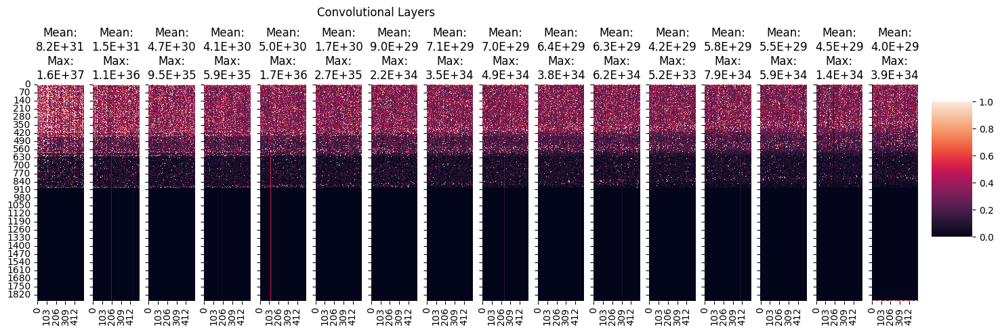

In [119]:
def absolute_error(actual, predicted):
    return np.abs(np.array(actual) - np.array(predicted))

fig, axn = plt.subplots(1, 16, figsize=(20,5), sharex=True, sharey=True)
cbar_ax = fig.add_axes([.91, .3, .03, .4])
    
for layer, ax in enumerate(axn.flat):
# for layer in range(1,17):
#     conv = []
#     for iteration in range(1,11):
#         print(iteration, layer)
    conv = pickle.load(open(f'embeddings/1_double_p9_r8_conv_{layer+1}_embeddings.pkl', 'rb'))[0]
    
    
#     conv_mean = np.mean(conv, axis=0)


    reduced_conv = pickle.load(open(f'embeddings/1_double_p8_r8_conv_{layer+1}_embeddings.pkl', 'rb'))[0]
    
    tmp = absolute_error(conv, reduced_conv)
    
    
    mae_conv = np.mean(np.abs(tmp / conv), axis=0)
                
    
    sns.heatmap(data=mae_conv, ax=ax,
                # cbar=True,
                cbar=layer == 0,
                vmin=0, vmax=1, #max across layers is 3.7e34
                cbar_ax=None if layer else cbar_ax
               )
    ax.set_title(f'Mean:\n{np.mean(mae_conv):.1E}\nMax:\n{np.amax(mae_conv):.1E}')

fig.suptitle(f"Convolutional Layers")
plt.subplots_adjust(top=0.75, left=.25)
plt.show()


<Axes: >

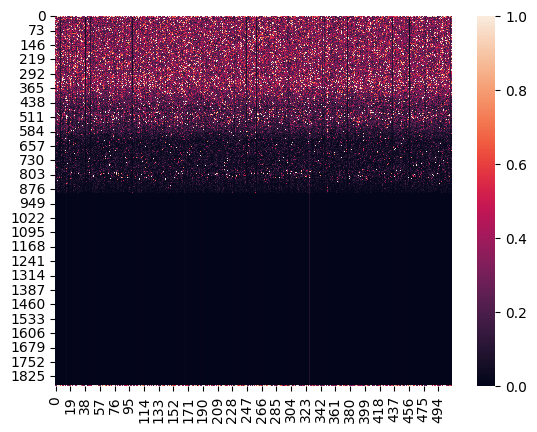

In [117]:
sns.heatmap(data=mae_conv,
                cbar=True,
                # cbar=layer == 0,
                vmin=0, vmax=1,
                # cbar_ax=None if layer else cbar_ax
               )